<h1>Credit Score Prediction</h1>

The goal of this project is to predict a creditscore from 304 financial book attributes.


Supervised machine learning method implementation step are:

<ol>
  <li>EDA</li>
  <li>feature engineering</li>
  <li>feature selection</li>
  <li>classification</li>
  <li>discussion</li>
</ol>

<b>About the data from the publisher</b><br>
We provide you with a data set in CSV format.<br>
The data set contains 8,000 train instances and 2000 test instance<br>
There are 304 input features, labeled x001 to x304.<br>
The target variable is labeled y.<br>

<b>Task: Create a model to predict the target variable y.</b><br>
A report - A Power point presentation<br>
Any custom code you used<br>
Instructions for me to run your model on a separate data set<br>

<b>Link to hte dataset at Kaggle:</b><br> https://www.kaggle.com/prasy46/credit-score-prediction

<h2>1. EDA</h2>

In [1]:
# importing libraries
from platform import python_version
import warnings

# for working with arrays and dataframes
import numpy as np
import pandas as pd

# for plotting
import matplotlib.pyplot as plt #for plotting data
import seaborn as sns # for plotting data
import scipy
import scipy.stats as stats # for Q-Q plots


In [2]:
# showing versions
print('Python version:',python_version())
print('NumPy version:',np.__version__)
print('Pandas version:',pd.__version__)
print('SciPy version:',scipy.__version__)

Python version: 3.7.14
NumPy version: 1.21.6
Pandas version: 1.3.5
SciPy version: 1.7.3


In [3]:
# settings
warnings.filterwarnings('ignore')
pd.set_option('display.max_rows', None, 'display.max_columns', None)

In [4]:
# importing the train set
df_train = pd.read_csv("CreditScore_train.csv")
print(f"{df_train.shape[1]} columns, {df_train.shape[0]} rows")
# checking duplicated rows
print(f"{df_train.duplicated().sum()} duplicated rows")
df_train.head()

305 columns, 80000 rows
0 duplicated rows


,x001,x002,x003,x004,x005,x006,x007,x008,x009,x010,x011,x012,x013,x014,x015,x016,x017,x018,x019,x020,x021,x022,x023,x024,x025,x026,x027,x028,x029,x030,x031,x032,x033,x034,x035,x036,x037,x038,x039,x040,x041,x042,x043,x044,x045,x046,x047,x048,x049,x050,x051,x052,x053,x054,x055,x056,x057,x058,x059,x060,x061,x062,x063,x064,x065,x066,x067,x068,x069,x070,x071,x072,x073,x074,x075,x076,x077,x078,x079,x080,x081,x082,x083,x084,x085,x086,x087,x088,x089,x090,x091,x092,x093,x094,x095,x096,x097,x098,x099,x100,x101,x102,x103,x104,x105,x106,x107,x108,x109,x110,x111,x112,x113,x114,x115,x116,x117,x118,x119,x120,x121,x122,x123,x124,x125,x126,x127,x128,x129,x130,x131,x132,x133,x134,x135,x136,x137,x138,x139,x140,x141,x142,x143,x144,x145,x146,x147,x148,x149,x150,x151,x152,x153,x154,x155,x156,x157,x158,x159,x160,x161,x162,x163,x164,x165,x166,x167,x168,x169,x170,x171,x172,x173,x174,x175,x176,x177,x178,x179,x180,x181,x182,x183,x184,x185,x186,x187,x188,x189,x190,x191,x192,x193,x194,x195,x196,x197,x198,x199,x200,x201,x202,x203,x204,x205,x206,x207,x208,x209,x210,x211,x212,x213,x214,x215,x216,x217,x218,x219,x220,x221,x222,x223,x224,x225,x226,x227,x228,x229,x230,x231,x232,x233,x234,x235,x236,x237,x238,x239,x240,x241,x242,x243,x244,x245,x246,x247,x248,x249,x250,x251,x252,x253,x254,x255,x256,x257,x258,x259,x260,x261,x262,x263,x264,x265,x266,x267,x268,x269,x270,x271,x272,x273,x274,x275,x276,x277,x278,x279,x280,x281,x282,x283,x284,x285,x286,x287,x288,x289,x290,x291,x292,x293,x294,x295,x296,x297,x298,x299,x300,x301,x302,x303,x304,y
0,1084094,426.0,39.0,128.0,426.0,0,0,0,0,0,2,4,4,9,19,5,14,8,5,6,2,3,2,1,1,1,1,6,1,5,0,0,0,0,0,0,0,0,0,0,0.6959,197600,60073,140000.0,200.0,2,0,0,0,0,0,0,0,0,1,0,0.9754,0.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.0,0,0,0,0,0,0,1.0,0,0,0,0,0,0,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.0000,1.0000,2,2,2,2,2,2,0,0,0,967,812.0,27600.0,51633,426.0,62.0,244.0000,0,0,NaN,0,1,1,1,1,1,1,9,2,0,1.0,0,61.0,53.0,57.0,483322,0.8827,1,1,1,0,0,NaN,NaN,NaN,NaN,0,0,0,0.1943,484289,0,NaN,0,0,0,484289,0,484289,1,1,1,0,0,1.0,NaN,NaN,NaN,0,346762,NaN,0,NaN,0,NaN,0,0,0,0,NaN,0,NaN,807
1,1287777,160.0,2.0,64.0,160.0,1,1,2,0,1,3,3,7,5,21,5,16,5,3,9,2,3,1,9,1,1,1,3,9,6,0,0,0,0,0,0,0,0,0,0,0.0269,25000,24327,18000.0,600.0,2,0,0,0,0,0,0,0,0,0,0,0.0557,0.0077,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.0,0,0,0,0,0,0,1.0,0,0,0,0,0,0,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.0000,1.0000,2,2,2,2,1,0,0,0,0,673,557.0,18000.0,24327,160.0,102.0,131.0000,1,0,NaN,0,1,1,1,1,1,1,3,1,0,1.0,0,49.0,49.0,49.0,107316,0.9172,1,1,1,1,17318,9.0,2.0,5.5,0.8417,1,1,1,0.2356,125307,0,NaN,0,0,0,125307,0,125307,1,1,1,2,0,1.0,9.0,2.0,5.5,17318,124634,0.8417,0,NaN,17318,0.8417,1,1,1,0,NaN,0,NaN,819
2,1483016,163.0,16.0,104.0,239.0,0,0,0,1,0,1,0,0,6,8,3,5,4,2,7,3,3,2,0,0,0,1,0,0,4,1,0,0,0,1,1,0,0,0,1,0.0458,15400,14694,9000.0,500.0,1,1,0,0,0,0,0,0,0,0,0,0.1079,0.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.0,0,0,0,0,0,0,NaN,0,0,0,0,0,0,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.6666,0.6666,2,2,2,2,0,0,0,0,0,706,637.0,9000.0,14694,163.0,16.0,104.3333,0,0,NaN,0,1,1,1,1,0,0,0,0,0,NaN,0,NaN,NaN,NaN,0,NaN,0,0,0,0,0,NaN,NaN,NaN,NaN,0,0,0,0.0308,706,0,NaN,0,0,0,706,0,706,1,1,1,0,0,NaN,NaN,NaN,NaN,0,0,NaN,0,NaN,0,NaN,0,0,0,0,NaN,0,NaN,803
3,959054,NaN,NaN,NaN,102.0,0,0,0,0,0,0,2,2,0,4,0,4,2,0,0,0,0,0,3,0,0,0,0,0,0,7,0,0,1,4,6,0,0,1,3,NaN,0

In [5]:
# showing data types
df_train.dtypes

x001      int64
x002    float64
x003    float64
x004    float64
x005    float64
x006      int64
x007      int64
x008      int64
x009      int64
x010      int64
x011      int64
x012      int64
x013      int64
x014      int64
x015      int64
x016      int64
x017      int64
x018      int64
x019      int64
x020      int64
x021      int64
x022      int64
x023      int64
x024      int64
x025      int64
x026      int64
x027      int64
x028      int64
x029      int64
x030      int64
x031      int64
x032      int64
x033      int64
x034      int64
x035      int64
x036      int64
x037      int64
x038      int64
x039      int64
x040      int64
x041    float64
x042      int64
x043      int64
x044    float64
x045    float64
x046      int64
x047      int64
x048      int64
x049      int64
x050      int64
x051      int64
x052      int64
x053      int64
x054      int64
x055      int64
x056      int64
x057    float64
x058    float64
x059      int64
x060      int64
x061      int64
x062      int64
x063    

In [6]:
# making a list of the variables that contain missing values
vars_with_na = [
    var for var in df_train.columns if df_train[var].isnull().sum() > 0]

# determining percentage of missing values (expressed as decimals)
# and displaying the result ordered by percent of missin data
print(len(vars_with_na), end='\n\n')
df_train[vars_with_na].isnull().mean().sort_values(ascending=False)

41



x242    0.933875
x295    0.865962
x304    0.818200
x098    0.806713
x155    0.791412
x259    0.775438
x255    0.770175
x257    0.770175
x256    0.770175
x302    0.730888
x268    0.673288
x162    0.665500
x267    0.665262
x266    0.665262
x265    0.665262
x253    0.663937
x297    0.580475
x275    0.562588
x293    0.511138
x289    0.497362
x290    0.497362
x288    0.497362
x148    0.418375
x223    0.371138
x222    0.370312
x041    0.368925
x058    0.368925
x057    0.368925
x238    0.367925
x239    0.367925
x237    0.367925
x287    0.247975
x002    0.214812
x003    0.214812
x004    0.214762
x235    0.201187
x045    0.196912
x044    0.196912
x234    0.191450
x272    0.071900
x005    0.060838
dtype: float64

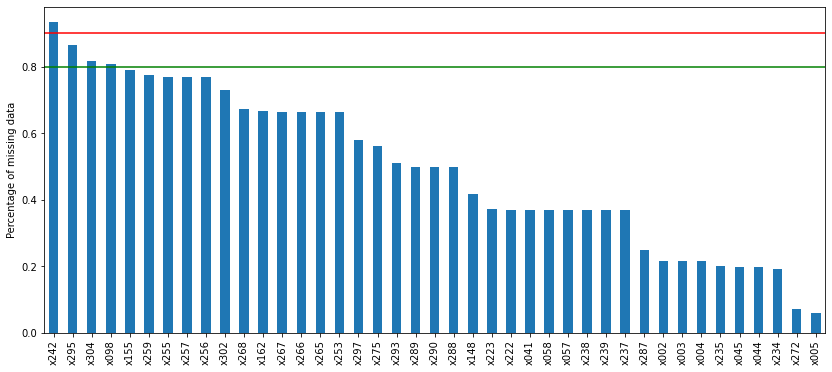

In [7]:
# plotting variables with n/a

df_train[vars_with_na].isnull().mean().sort_values(
    ascending=False).plot.bar(figsize=(14, 6))
plt.ylabel('Percentage of missing data')
plt.axhline(y=0.90, color='r', linestyle='-')
plt.axhline(y=0.80, color='g', linestyle='-')

<b>Relationship between missing data and credit score</b>

Evaluating a credit score in those observations where information is missing. Doing this for each variable that shows missing data.

In [8]:
def analyse_na_value(df, var):
    # copy of the dataframe, so that we do not override the original data
    df = df.copy()

    # making an interim variable that indicates 1 if the
    # observation was missing or 0 otherwise
    df[var] = np.where(df[var].isnull(), 1, 0)

    # comparing the mean y in the observations where data is missing
    # vs the observations where data is available

    # determining the mean price in the groups 1 and 0,
    # and the standard deviation of the sale price,
    # and capturing the results in a temporary dataset
    tmp = df.groupby(var)['y'].agg(['mean', 'std'])

    # plotting into a bar graph
    tmp.plot(kind="barh", y="mean", legend=False,
             xerr="std", title="Credit score", color='green')

    plt.show()

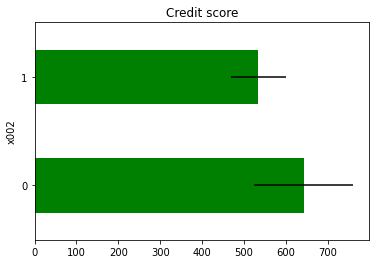

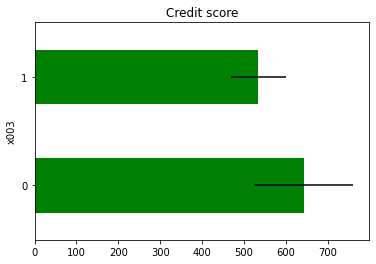

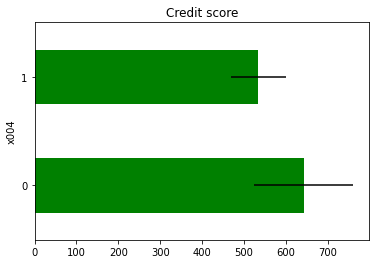

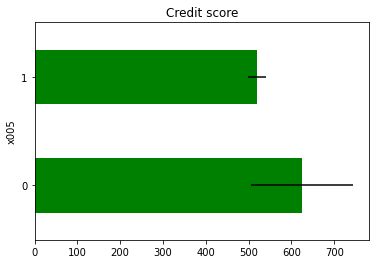

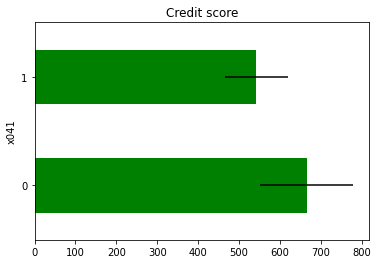

...

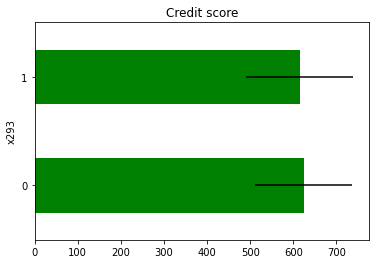

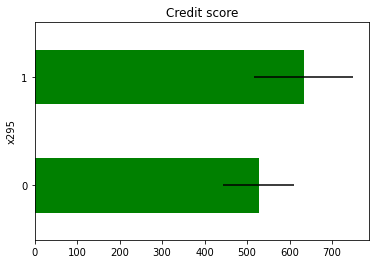

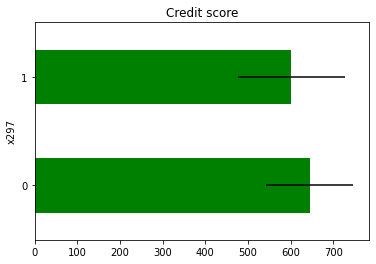

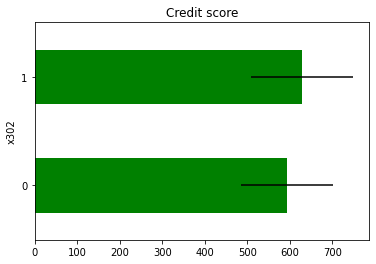

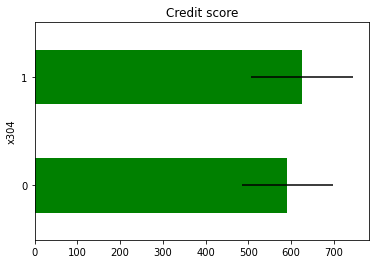

In [9]:
# running the function on each variable with missing data
for var in vars_with_na:
    analyse_na_value(df_train, var)

In some variables, the average credit score in cases where the information is missing, differs from the average credit score in case where information exists. This suggests that data being missing could be a good predictor of credit score.

These sugested predictors are [
 'x002',
 'x003',
 'x004',
 'x005',
 'x041',
 'x044',
 'x045',
 'x057',
 'x058',
 'x098',
 'x148',
 'x155',
 'x222',
 'x223',
 'x234',
 'x235',
 'x237',
 'x238',
 'x239',
 'x242',
 'x253',
 'x255',
 'x256',
 'x257',
 'x259',
 'x272',
 'x275',
 'x295']

<b>Numerical variables</b>

In [10]:
# defining the target variable
target = 'y'

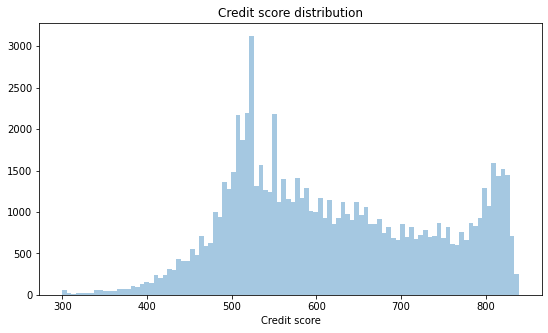

In [11]:
# plotting distribution of the target
plt.figure(figsize=(9, 5))
ax = sns.distplot(df_train['y'], bins=100, kde=False)
plt.title('Credit score distribution')
plt.xlabel('Credit score');

Discrete variables

In [12]:
#  making a list of discrete variables
discrete_vars = [
    var for var in df_train.columns if len(df_train[var].unique()) < 30]
print('Number of discrete variables: ', len(discrete_vars))

Number of discrete variables:  142


In [13]:
# showing the discrete variables
df_train[discrete_vars].head()

,x006,x010,x018,x019,x022,x023,x025,x026,x027,x032,x037,x038,x039,x040,x046,x047,x048,x049,x050,x051,x052,x053,x054,x055,x056,x060,x061,x062,x067,x068,x069,x070,x071,x076,x077,x078,x079,x080,x081,x082,x083,x084,x085,x086,x087,x088,x089,x090,x091,x092,x093,x094,x095,x096,x097,x099,x100,x101,x102,x103,x104,x105,x107,x108,x109,x110,x112,x113,x122,x123,x124,x132,x147,x148,x149,x150,x154,x155,x156,x157,x161,x162,x163,x164,x168,x169,x170,x171,x172,x173,x174,x175,x176,x177,x178,x179,x180,x182,x183,x184,x187,x197,x198,x207,x225,x226,x227,x228,x229,x230,x231,x241,x244,x245,x246,x247,x248,x249,x251,x252,x253,x254,x260,x261,x262,x263,x269,x270,x271,x276,x277,x278,x282,x283,x284,x286,x287,x298,x299,x300,x301,x302
0,0,0,8,5,3,2,1,1,1,0,0,0,0,0,2,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.0,0,0,0,1.0,0,0,0,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,2,2,2,2,0,0,0,1,1,1,1,1,1,2,0,1.0,0,1,1,1,0,0,0,0,0,0,0,1,1,1,0,1.0,0,0,0,0,NaN
1,1,1,5,3,3,1,1,1,1,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.0,0,0,0,1.0,0,0,0,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,2,2,1,0,0,0,0,1,1,1,1,1,1,1,0,1.0,0,1,1,1,1,1,1,1,0,0,0,1,1,1,0,1.0,1,1,1,0,NaN
2,0,0,4,2,3,2,0,0,1,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.0,0,0,0,NaN,0,0,0,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,2,2,0,0,0,0,0,1,1,1,1,0,0,0,0,NaN,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,NaN,0,0,0,0,NaN
3,0,0,2,0,0,0,0,0,0,0,0,0,1,3,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,0,0,0,NaN,0,0,0,NaN,0,0,2,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,9.0,1,1,1,0,NaN
4,0,0,2,2,1,1,0,1,1,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0,1,1,0,0,0,0,1,3.0,1,1,0,NaN,0,0,0,1.0,0,0,3,0,0,0,1,3,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,0,0,0,0,NaN,0,0,0,0,1,1,1,1,1,1,1,1,1,1,0,9.0,1,1,1,0,NaN


 Analysing contribution of the discrete variables to the credit score

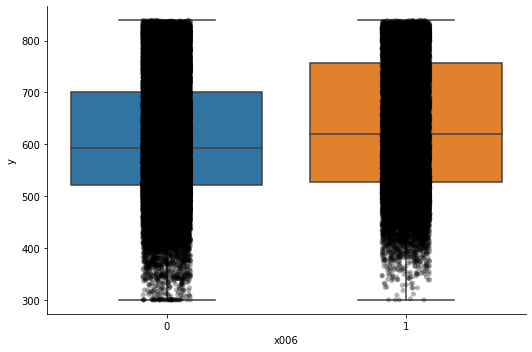

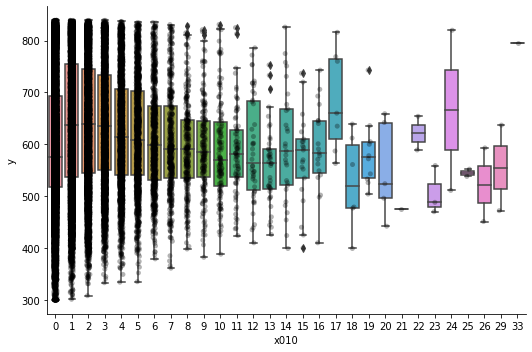

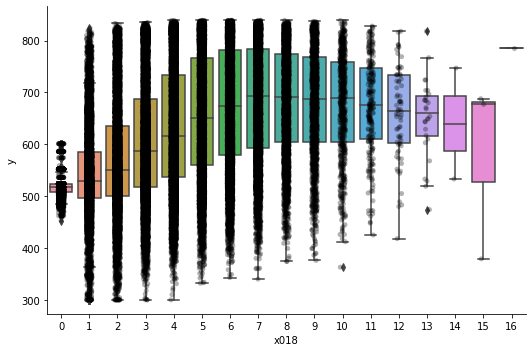

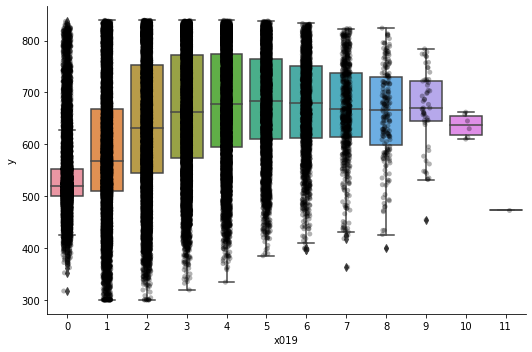

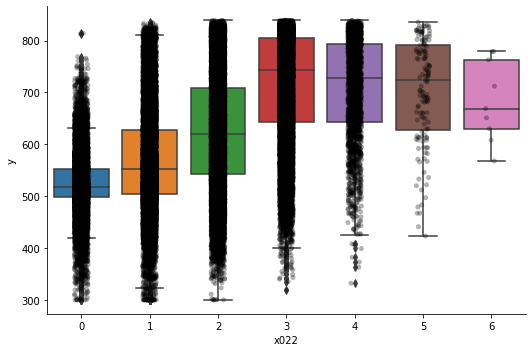

...

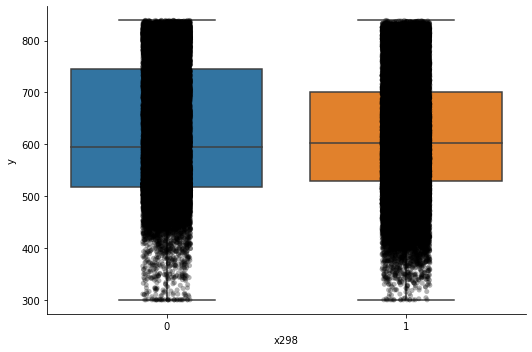

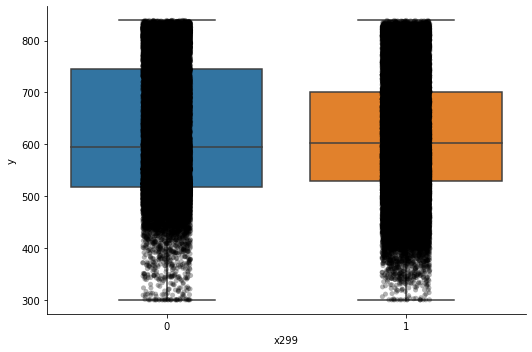

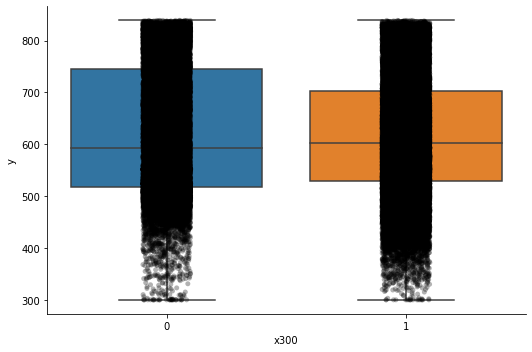

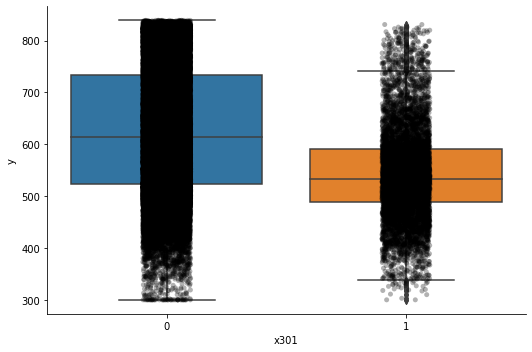

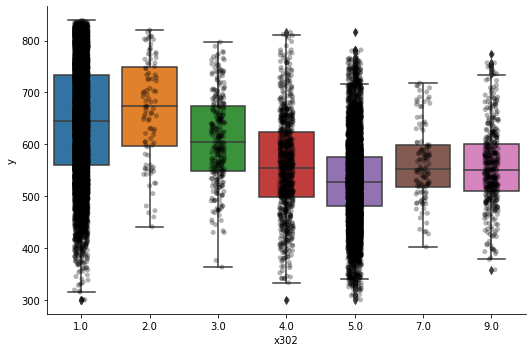

In [14]:
for var in discrete_vars:
    # make boxplot with Catplot
    sns.catplot(x=var, y='y', data=df_train, kind="box", height=5, aspect=1.5)
    # add data points to boxplot with stripplot
    sns.stripplot(x=var, y='y', data=df_train, jitter=0.1, alpha=0.3, color='k')
    plt.show()

In some variables, the average credit score differs from value to value. This suggests that those vatiables could be a good predictor of credit score.

These sugested predictors are [
 'x010',
 'x018',
 'x019',
 'x022',
 'x023',
 'x025',
 'x026',
 'x027',
 'x039',
 'x040',
 'x046',
 'x047',
 'x048',
 'x049',
 'x050',
 'x051',
 'x052',
 'x053',
 'x056',
 'x060',
 'x061',
 'x062',
 'x068',
 'x069',
 'x070',
 'x071',
 'x076',
 'x077',
 'x078',
 'x079',
 'x080',
 'x081',
 'x089',
 'x093',
 'x097',
 'x099',
 'x100',
 'x101',
 'x102',
 'x103',
 'x104',
 'x105',
 'x107',
 'x108',
 'x109',
 'x110',
 'x112',
 'x113',
 'x122',
 'x123',
 'x124',
 'x132',
 'x147',
 'x148',
 'x149',
 'x150',
 'x154',
 'x155',
 'x156',
 'x157',
 'x161',
 'x162',
 'x163',
 'x164',
 'x168',
 'x169',
 'x170',
 'x171',
 'x172',
 'x173',
 'x174',
 'x175',
 'x176',
 'x177',
 'x178',
 'x179',
 'x180',
 'x183',
 'x184',
 'x187',
 'x197',
 'x198',
 'x207',
 'x225',
 'x226',
 'x227',
 'x228',
 'x229',
 'x230',
 'x231',
 'x241',
 'x244',
 'x245',
 'x246',
 'x247',
 'x248',
 'x249',
 'x251',
 'x252',
 'x253',
 'x254',
 'x260',
 'x261',
 'x262',
 'x276',
 'x277',
 'x278',
 'x282',
 'x283',
 'x284',
 'x286',
 'x287',
 'x301',
 'x302']

Continuous variables

In [15]:
# making a list of continuous variables
cont_vars =  [
    var for var in df_train.columns
    if var not in discrete_vars and var != target]
print('Number of continuous variables: ', len(cont_vars))

Number of continuous variables:  162


In [16]:
# function to create histogram, Q-Q plot and boxplot
def diagnostic_plots(df, variable):
    # function takes a dataframe (df) and
    # the variable of interest as arguments

    # define figure size
    plt.figure(figsize=(16, 4))

    # histogram
    plt.subplot(1, 3, 1)
    sns.histplot(df[variable], bins=30)
    plt.title('Histogram')

    # Q-Q plot
    plt.subplot(1, 3, 2)
    stats.probplot(df[variable], dist="norm", plot=plt)
    plt.ylabel('Variable quantiles')

    # boxplot
    plt.subplot(1, 3, 3)
    sns.boxplot(y=df[variable])
    plt.title('Boxplot')
    
    plt.show()

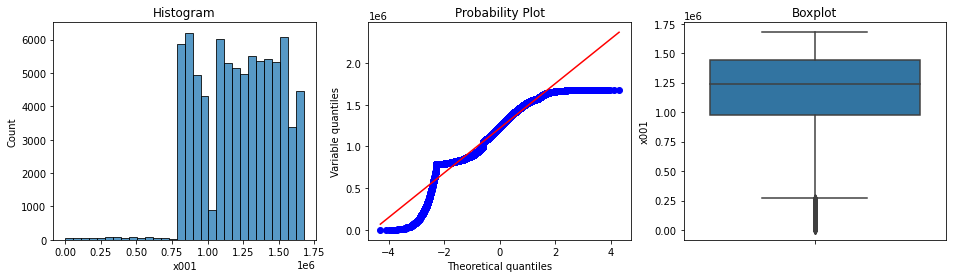

skewness of x001 is -0.36


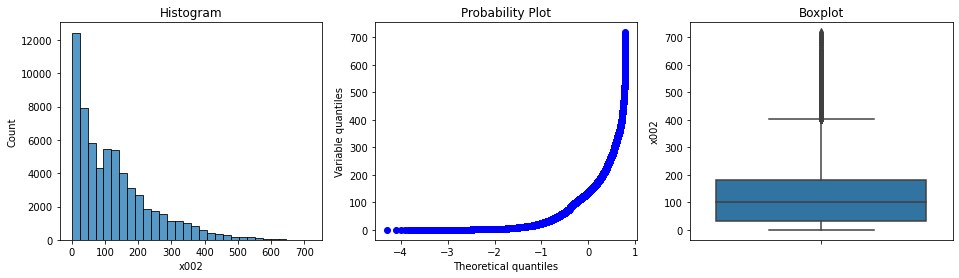

skewness of x002 is 1.31


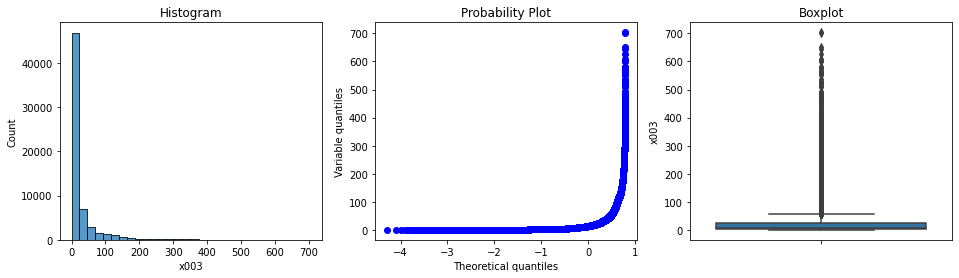

skewness of x003 is 4.17


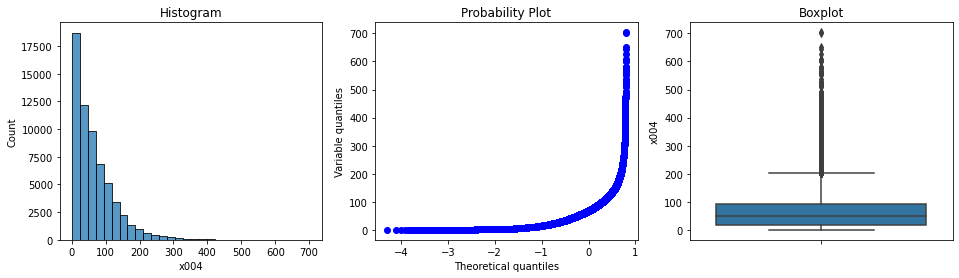

skewness of x004 is 2.01


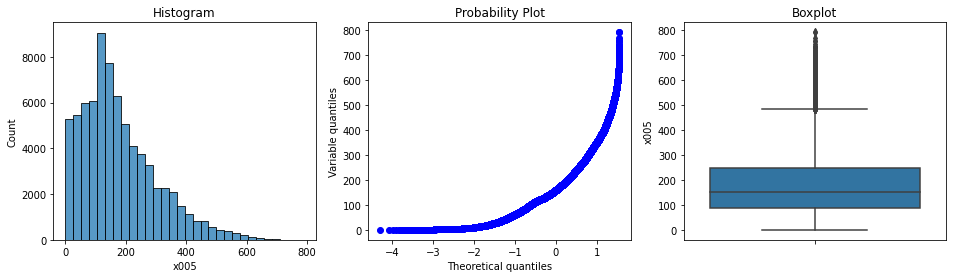

skewness of x005 is 1.03


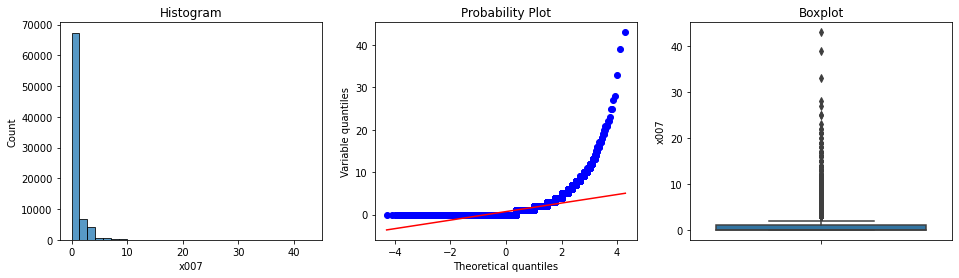

skewness of x007 is 4.82


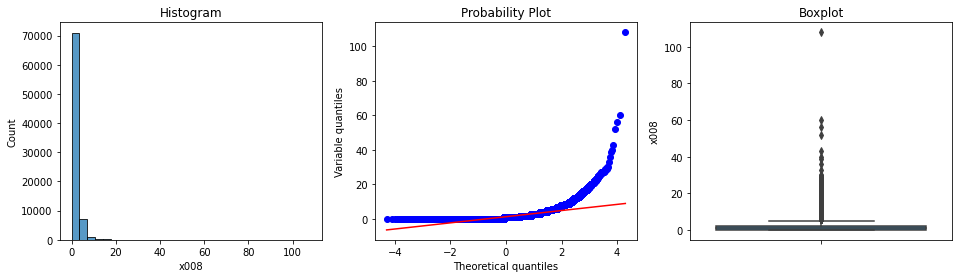

skewness of x008 is 5.21


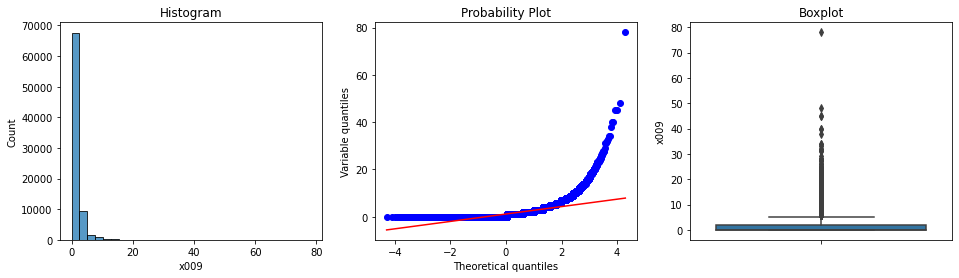

skewness of x009 is 4.82


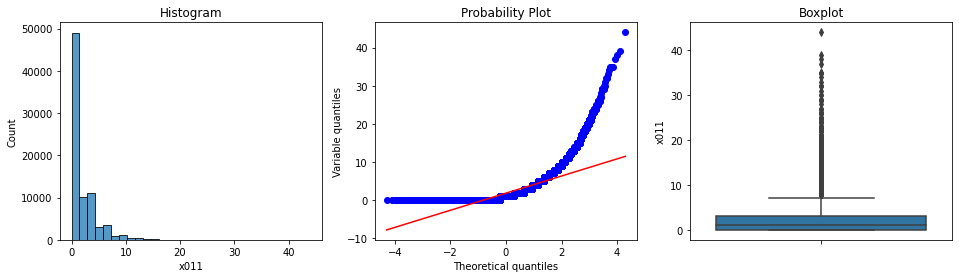

skewness of x011 is 2.95


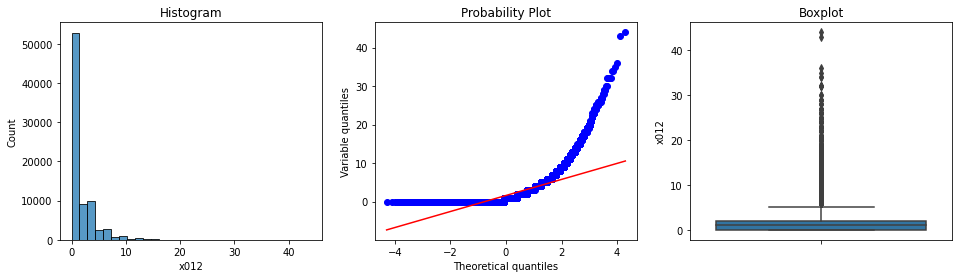

skewness of x012 is 3.22


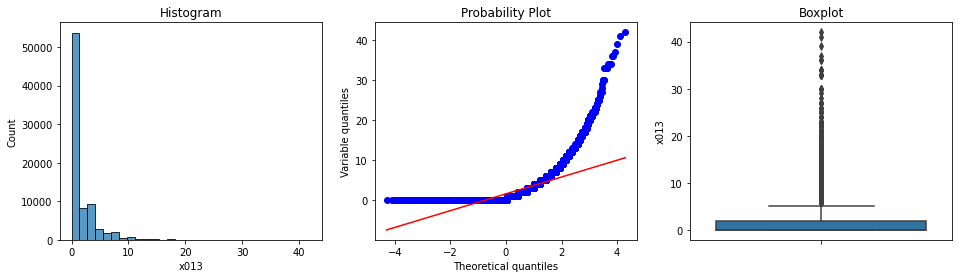

skewness of x013 is 3.17


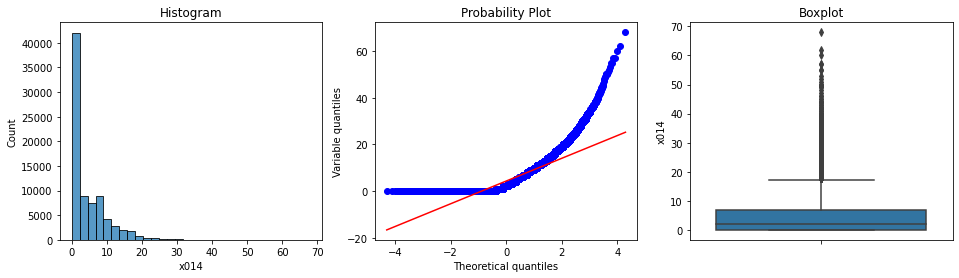

skewness of x014 is 1.86


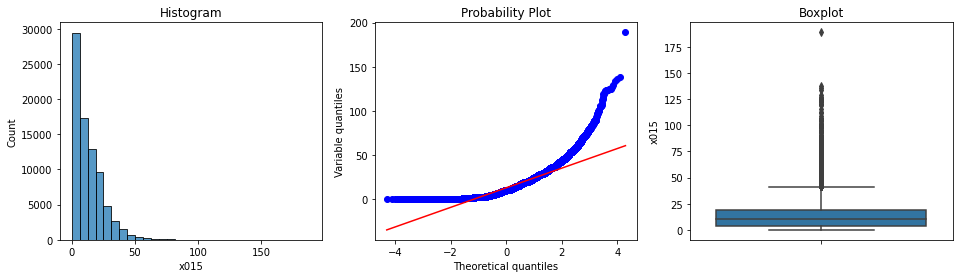

skewness of x015 is 1.78


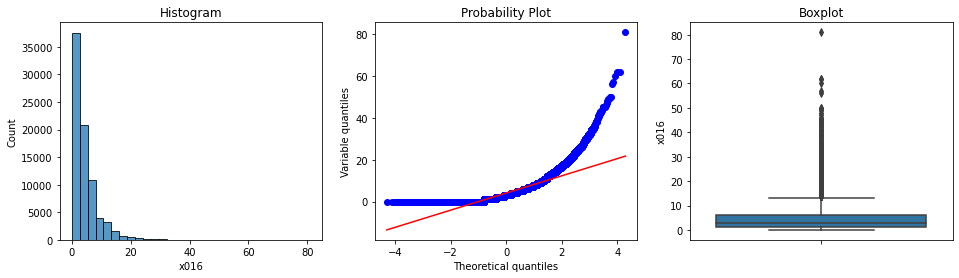

skewness of x016 is 2.30


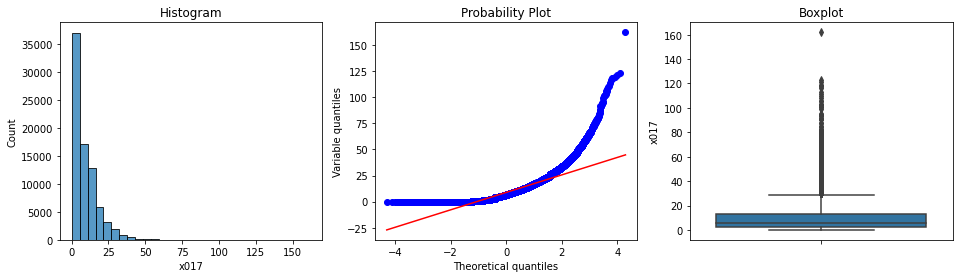

skewness of x017 is 2.23


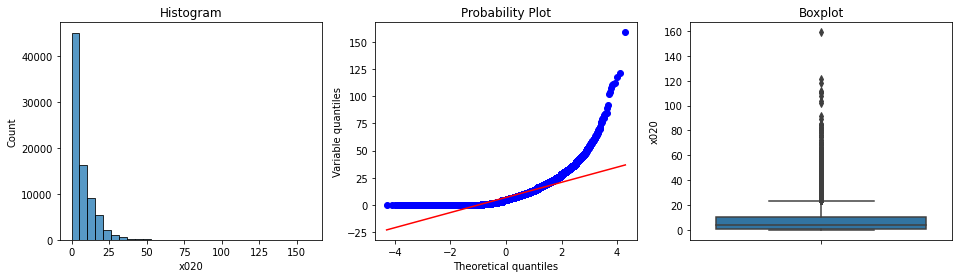

skewness of x020 is 2.35


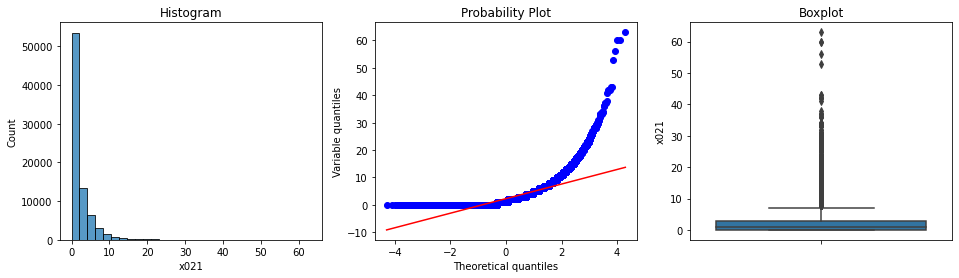

skewness of x021 is 3.09


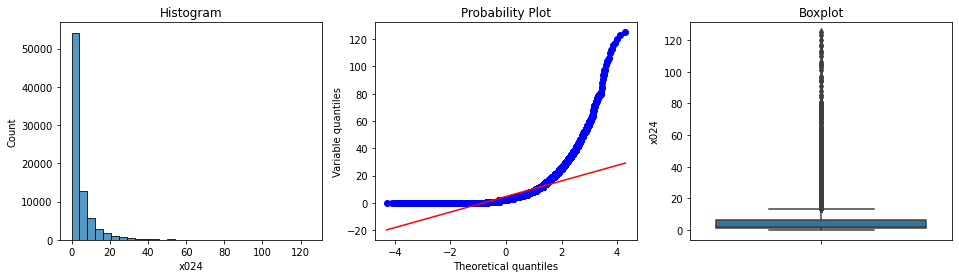

skewness of x024 is 3.88


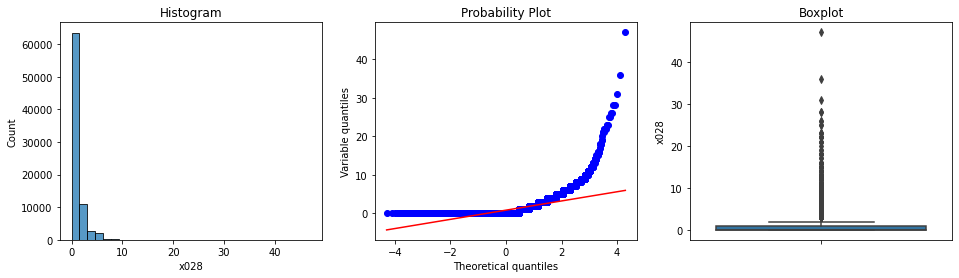

skewness of x028 is 3.68


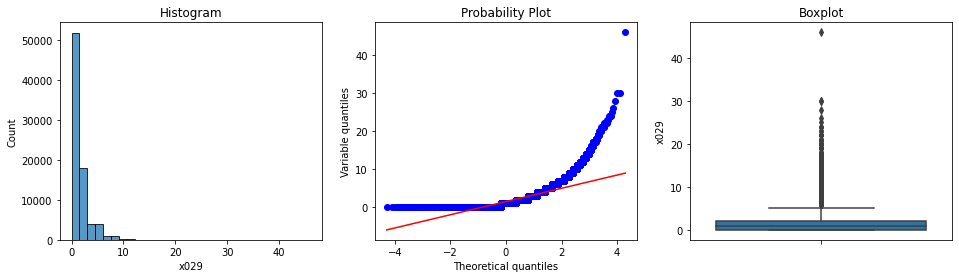

skewness of x029 is 2.66


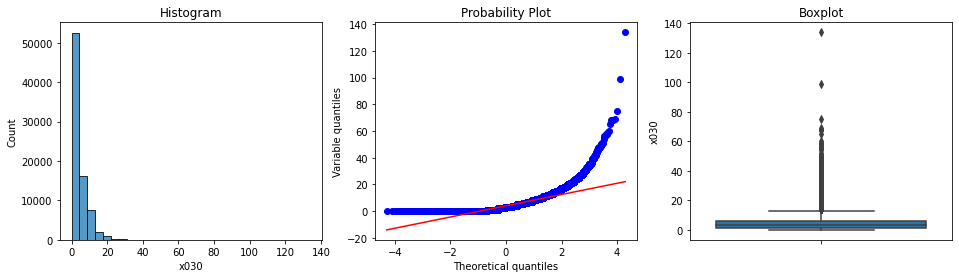

skewness of x030 is 2.75


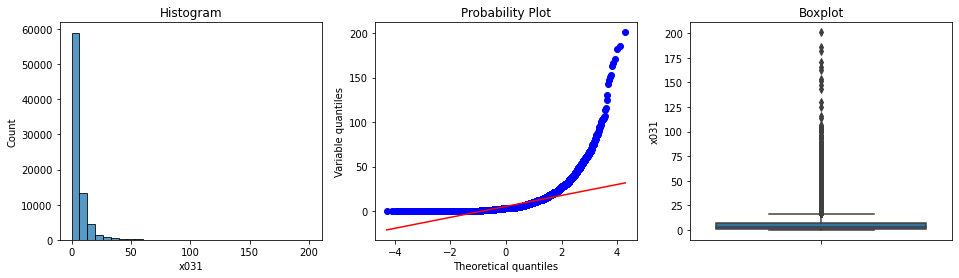

skewness of x031 is 4.66


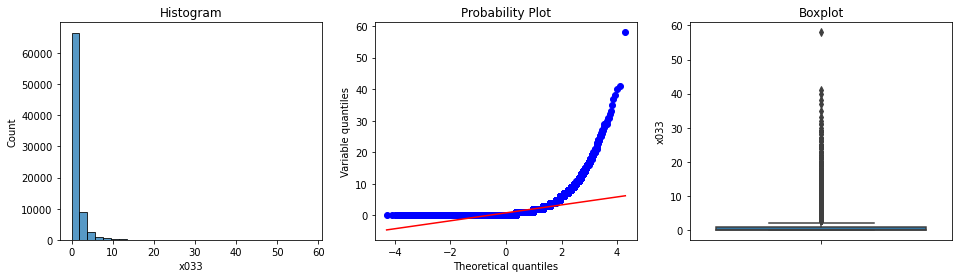

skewness of x033 is 5.67


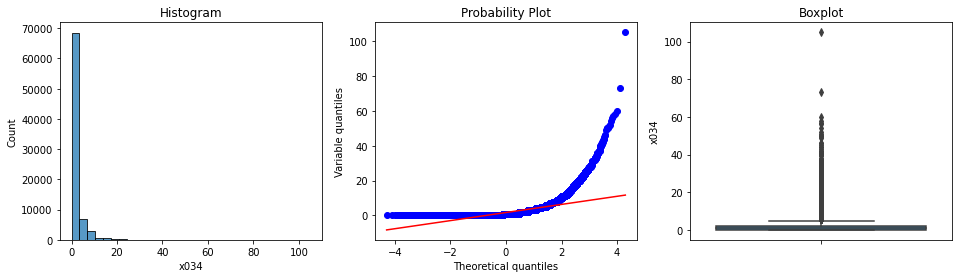

skewness of x034 is 5.06


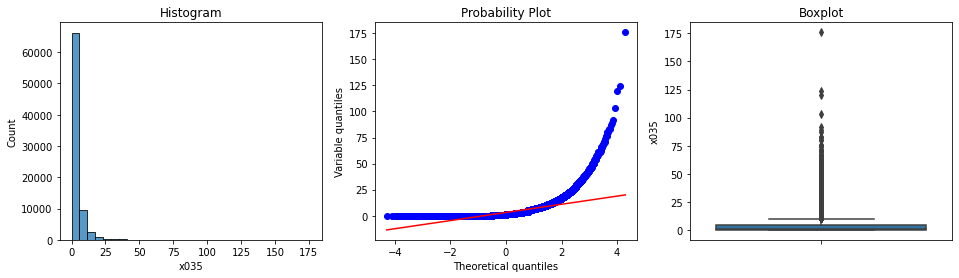

skewness of x035 is 4.95


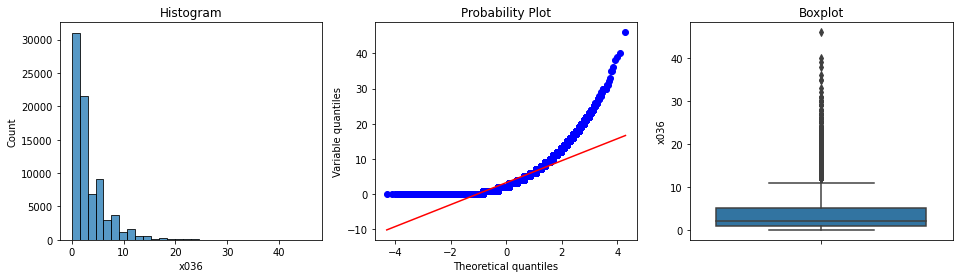

skewness of x036 is 2.01


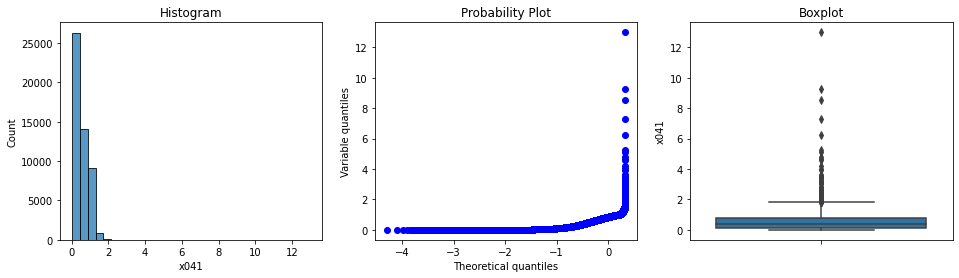

skewness of x041 is 1.87


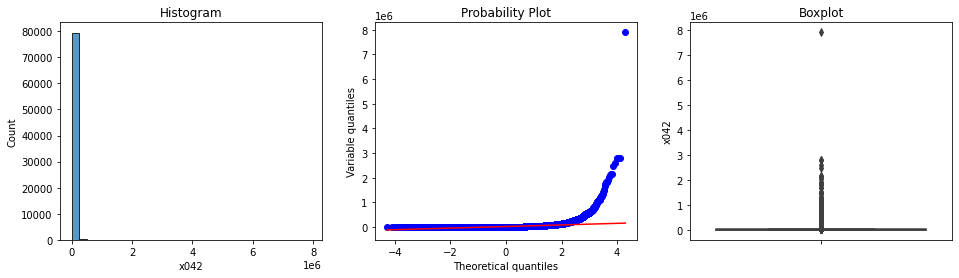

skewness of x042 is 34.05


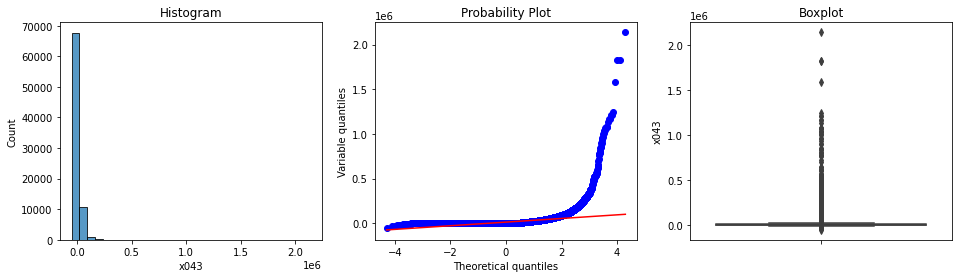

skewness of x043 is 16.61


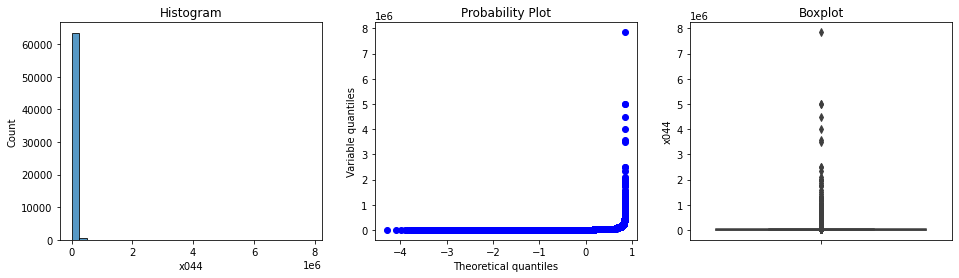

skewness of x044 is 29.20


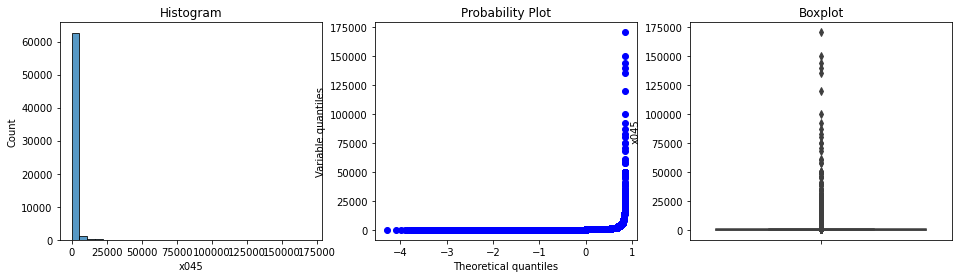

skewness of x045 is 21.56


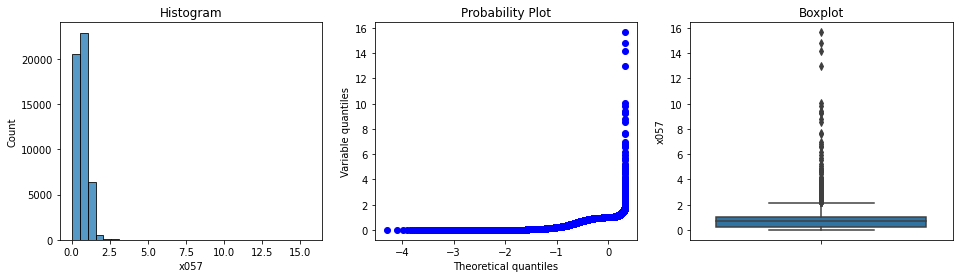

skewness of x057 is 3.29


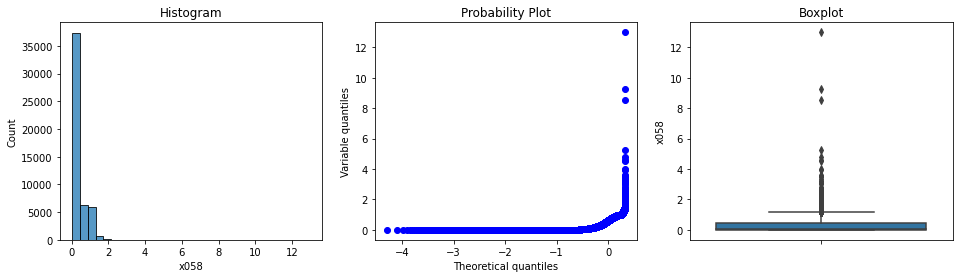

skewness of x058 is 2.51


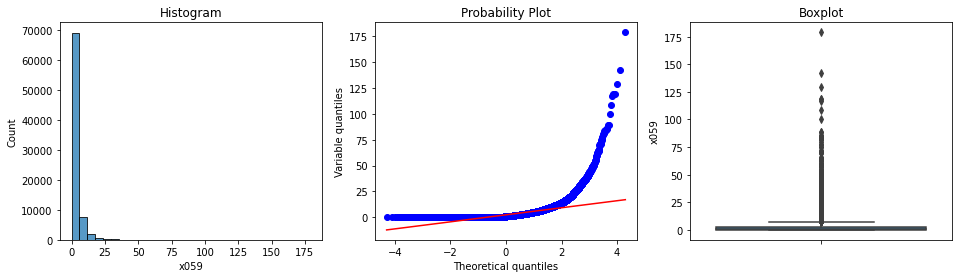

skewness of x059 is 6.60


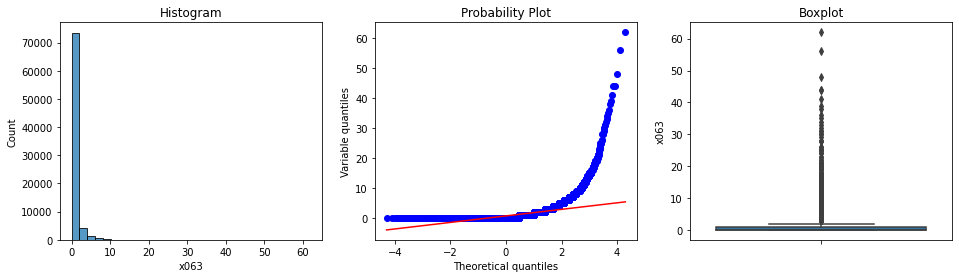

skewness of x063 is 7.24


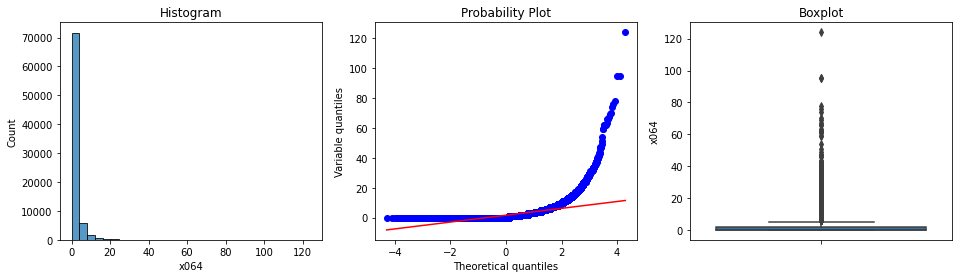

skewness of x064 is 6.65


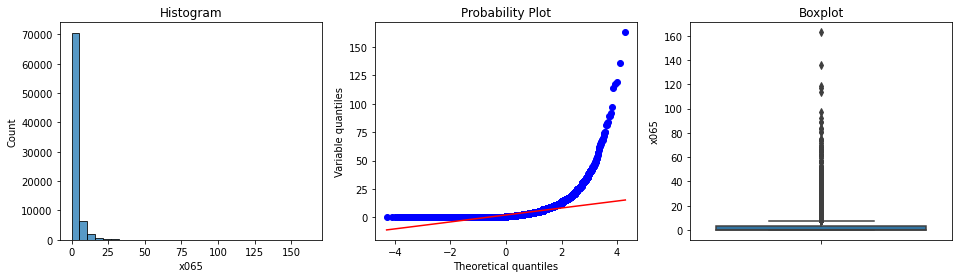

skewness of x065 is 6.70


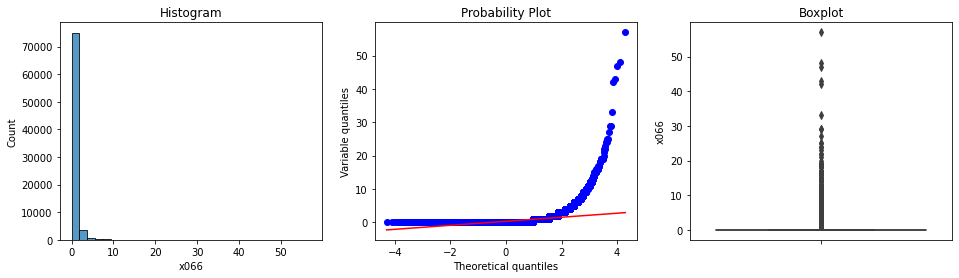

skewness of x066 is 11.60


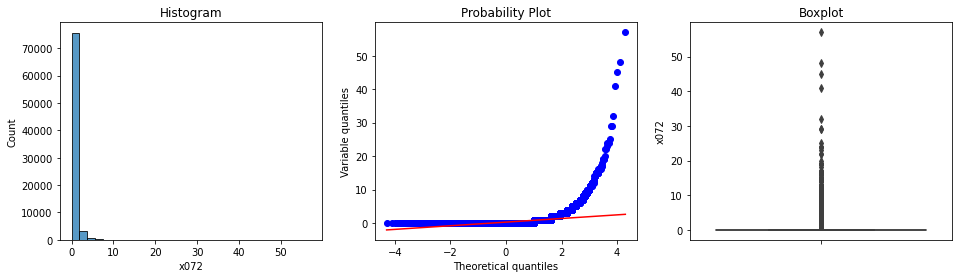

skewness of x072 is 12.34


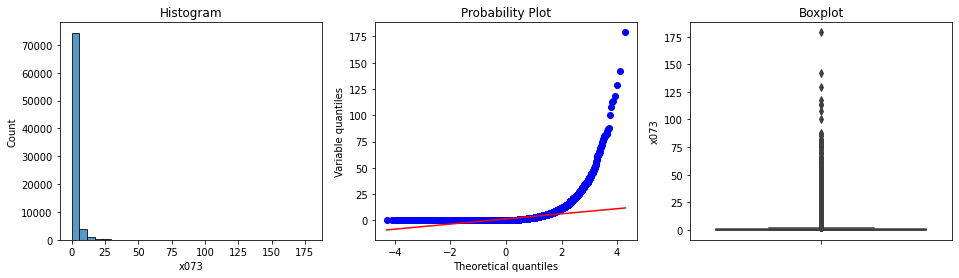

skewness of x073 is 9.23


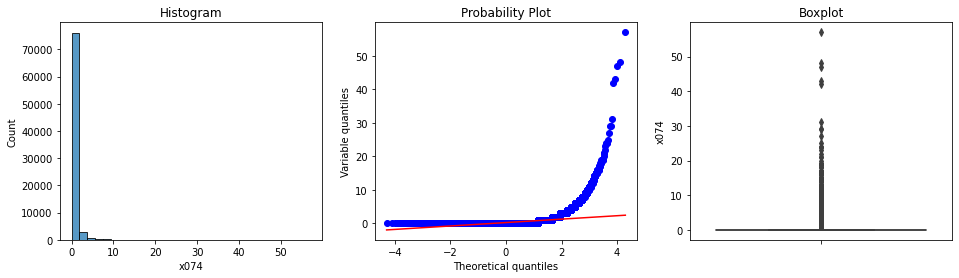

skewness of x074 is 13.34


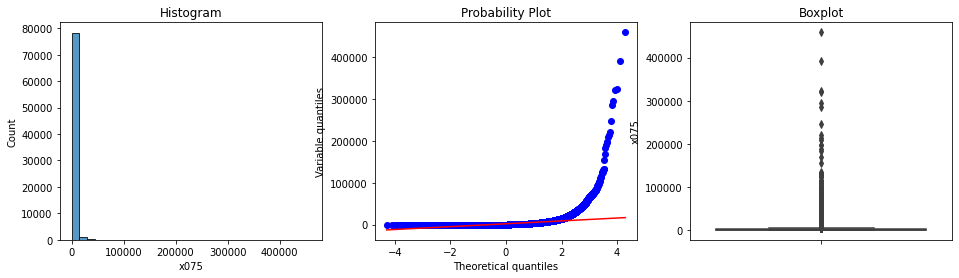

skewness of x075 is 20.32


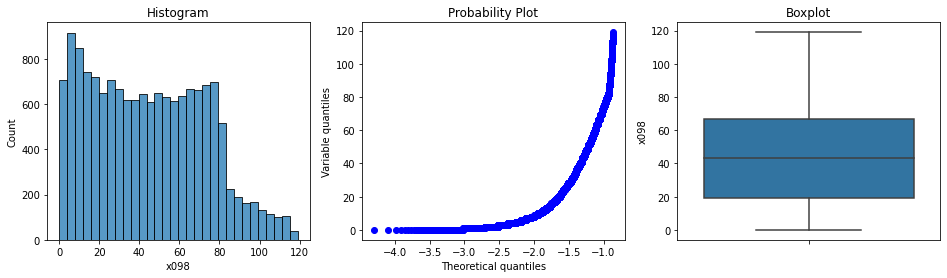

skewness of x098 is 0.29


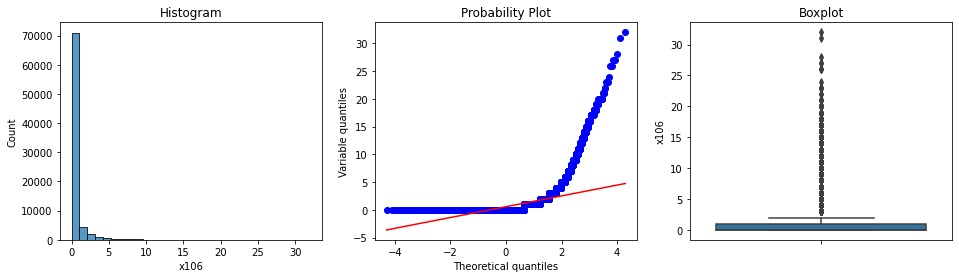

skewness of x106 is 5.92


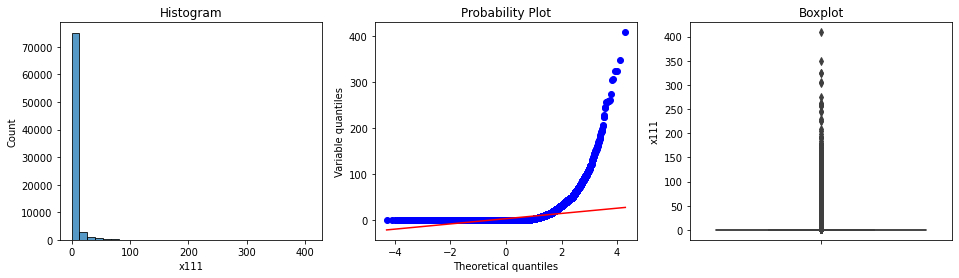

skewness of x111 is 9.73


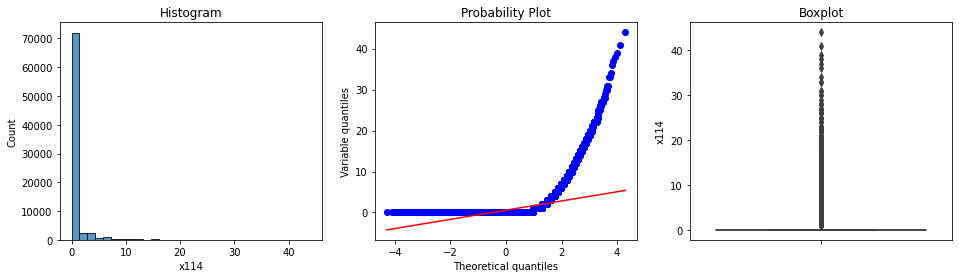

skewness of x114 is 6.11


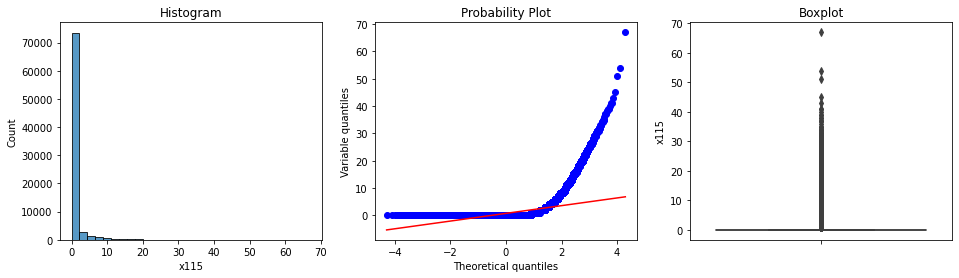

skewness of x115 is 6.40


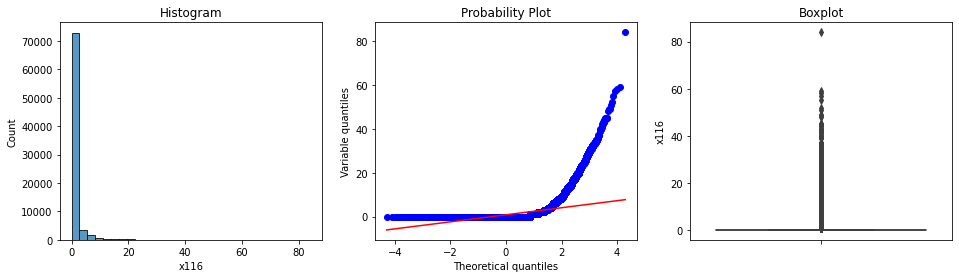

skewness of x116 is 6.76


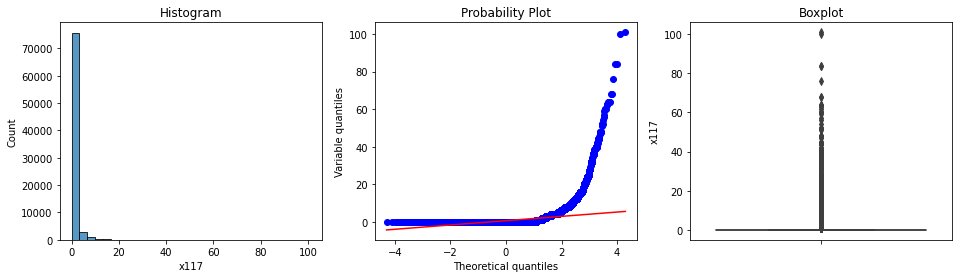

skewness of x117 is 12.69


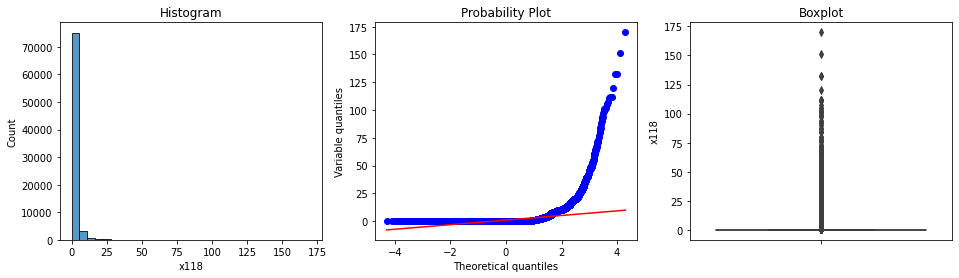

skewness of x118 is 11.69


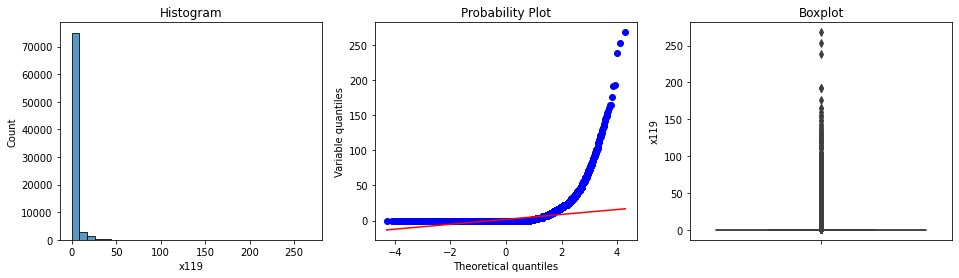

skewness of x119 is 10.26


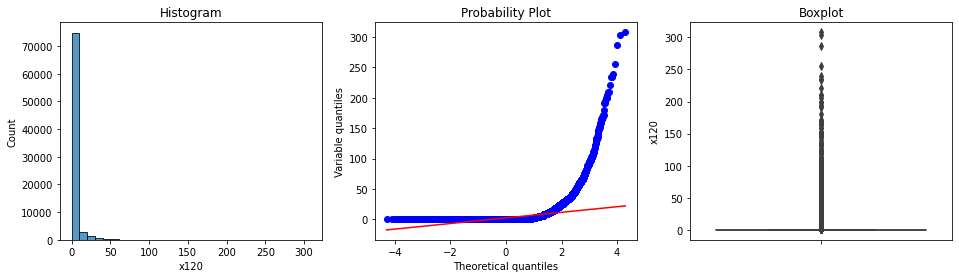

skewness of x120 is 9.89


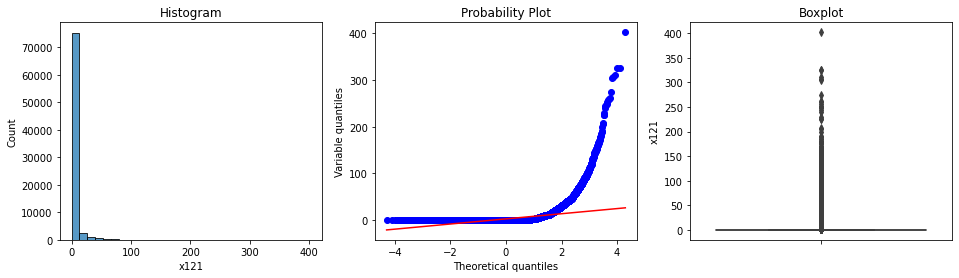

skewness of x121 is 9.93


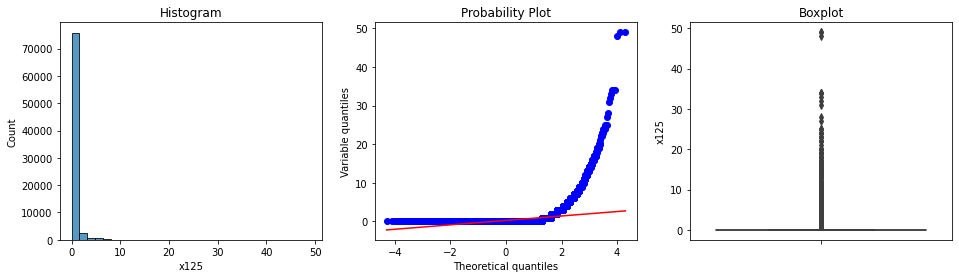

skewness of x125 is 10.74


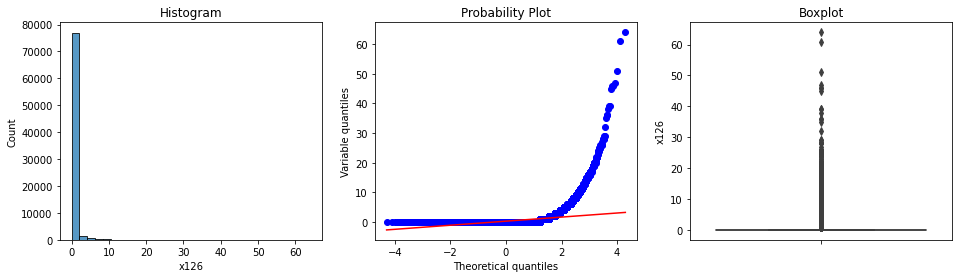

skewness of x126 is 11.43


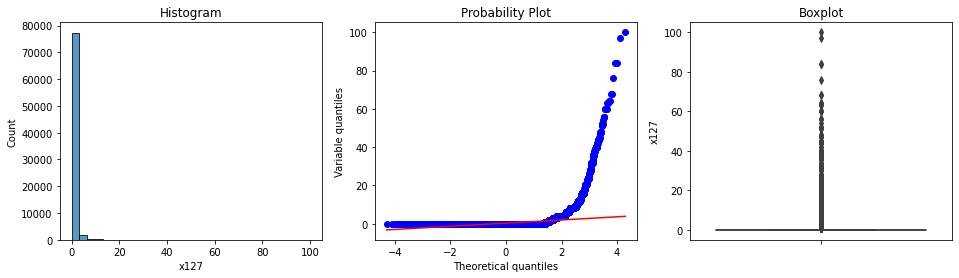

skewness of x127 is 16.45


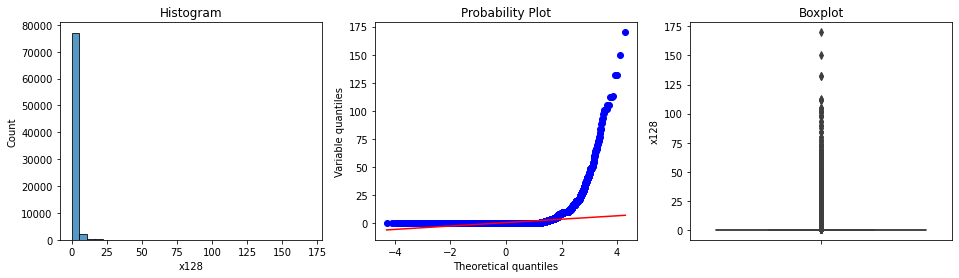

skewness of x128 is 14.94


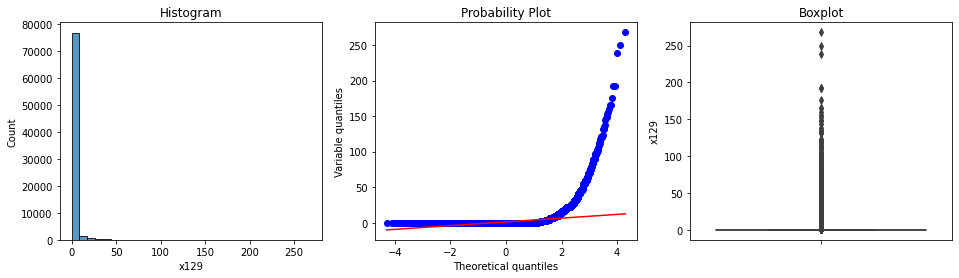

skewness of x129 is 12.91


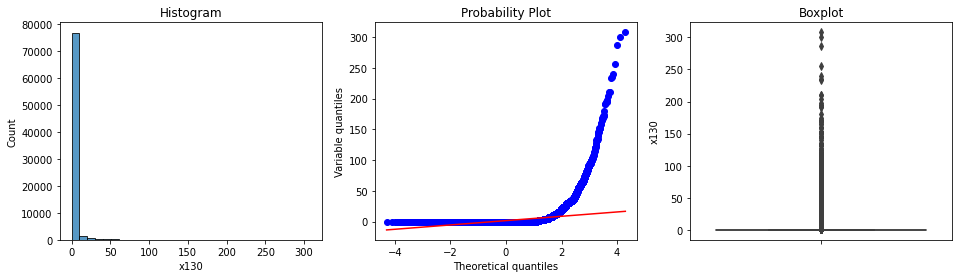

skewness of x130 is 12.19


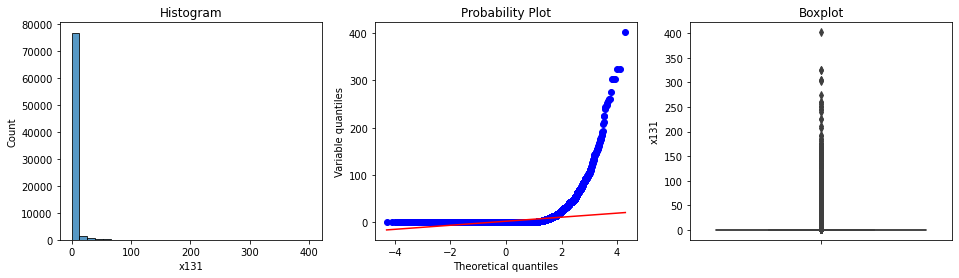

skewness of x131 is 12.08


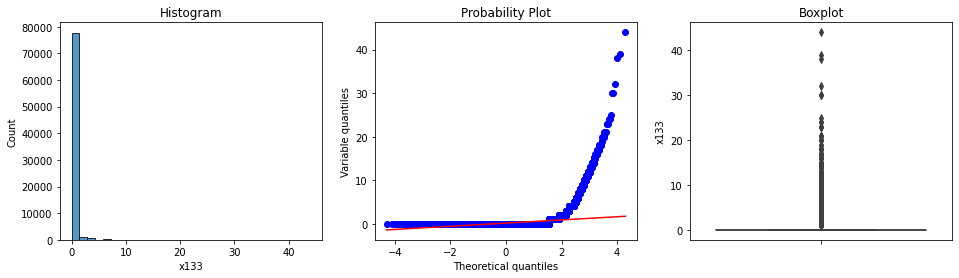

skewness of x133 is 13.61


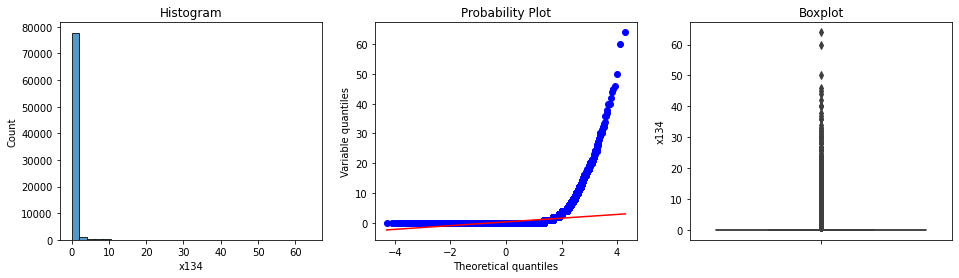

skewness of x134 is 12.50


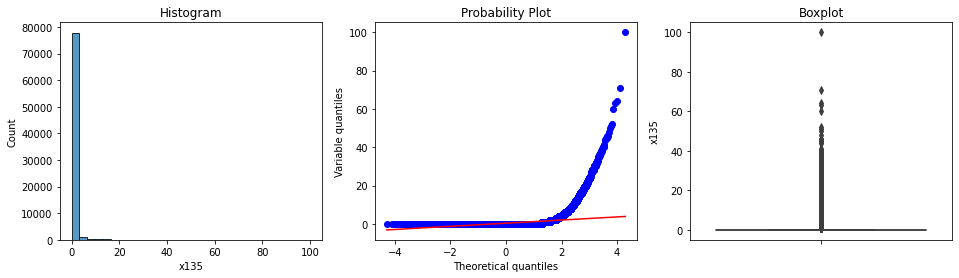

skewness of x135 is 12.72


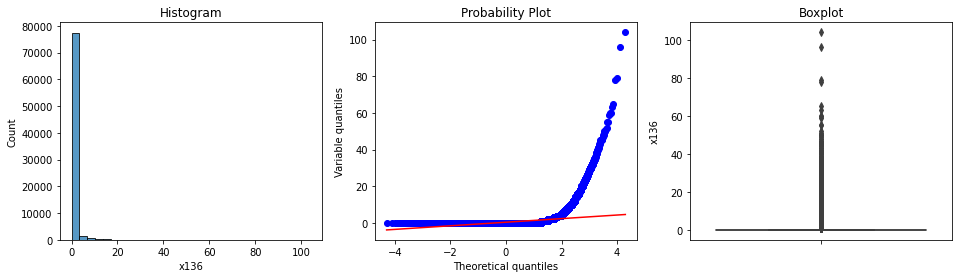

skewness of x136 is 12.56


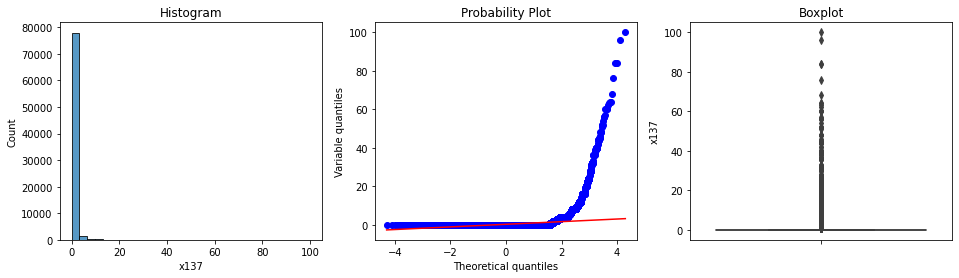

skewness of x137 is 18.45


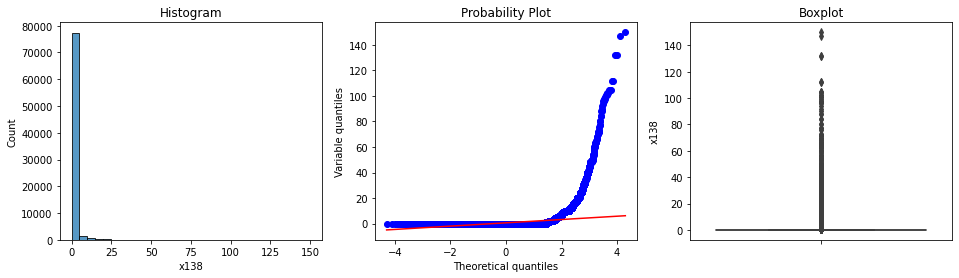

skewness of x138 is 15.91


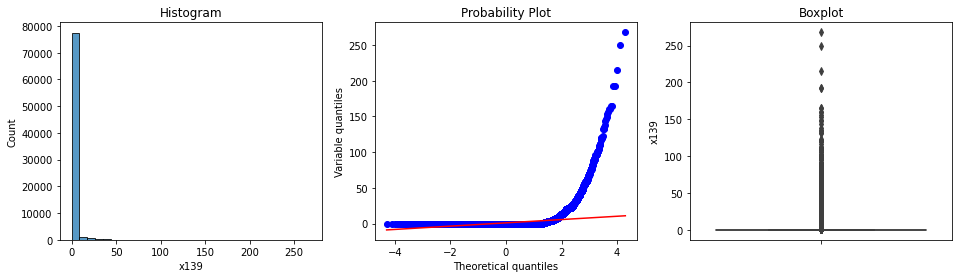

skewness of x139 is 13.78


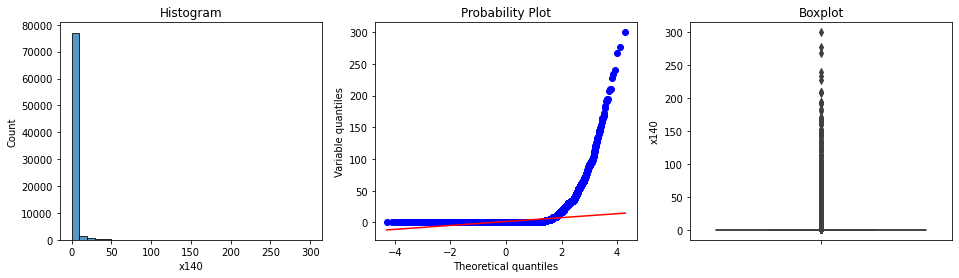

skewness of x140 is 12.72


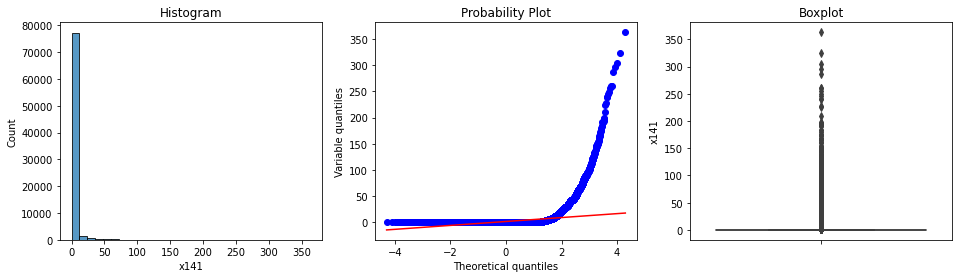

skewness of x141 is 12.44


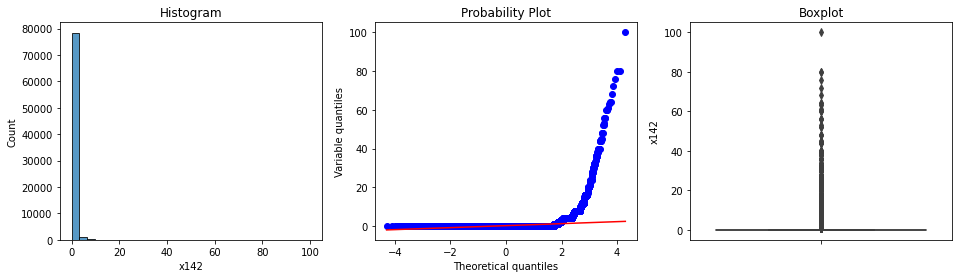

skewness of x142 is 21.83


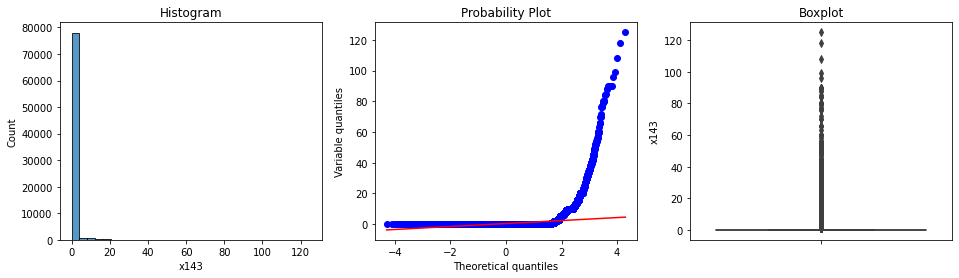

skewness of x143 is 16.72


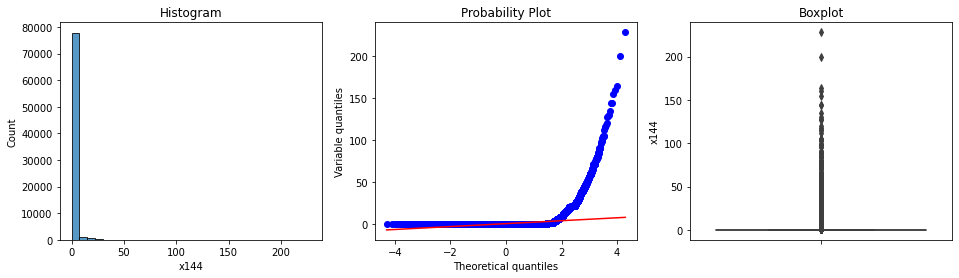

skewness of x144 is 14.24


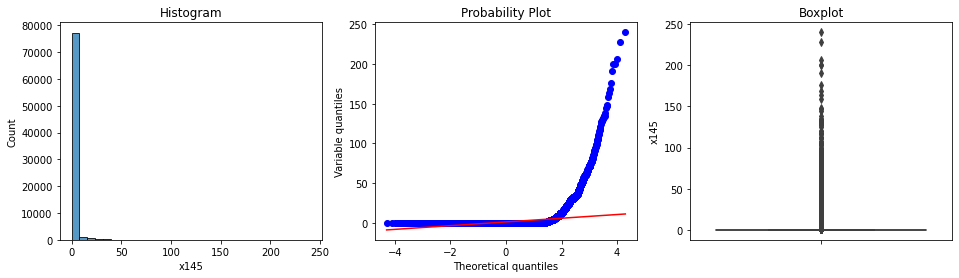

skewness of x145 is 12.85


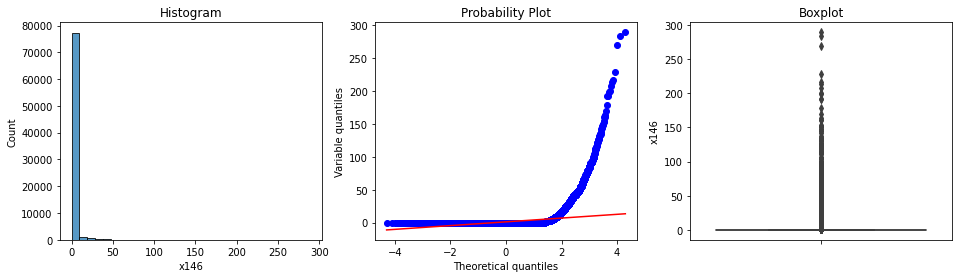

skewness of x146 is 12.55


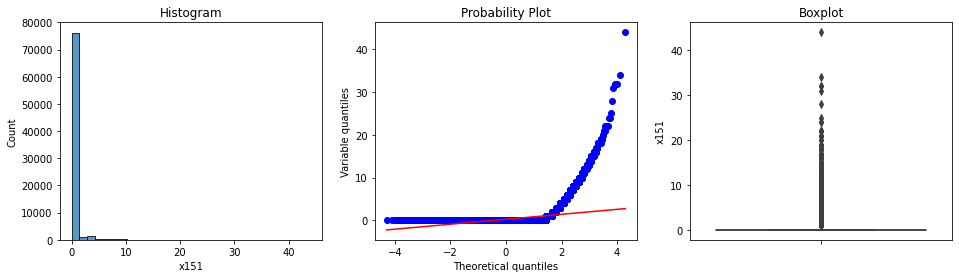

skewness of x151 is 8.33


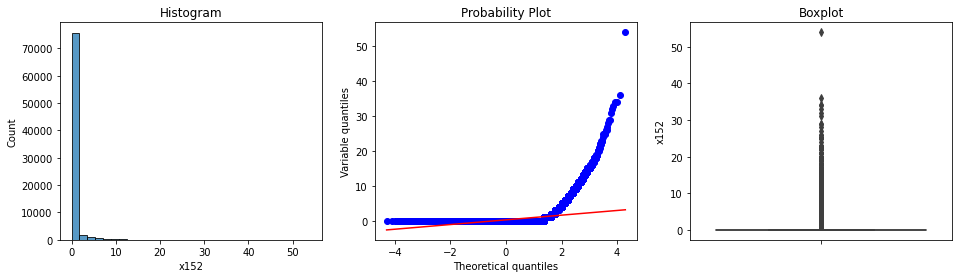

skewness of x152 is 8.38


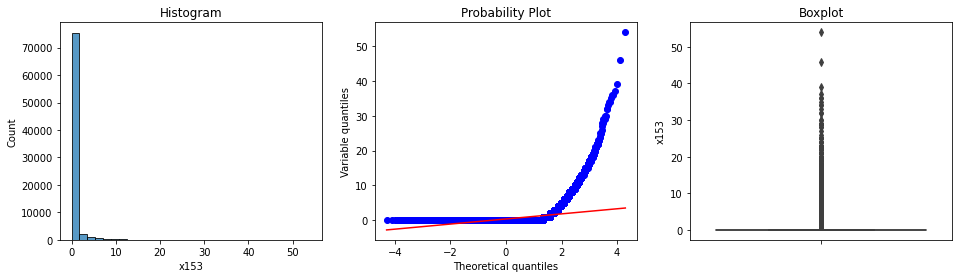

skewness of x153 is 8.65


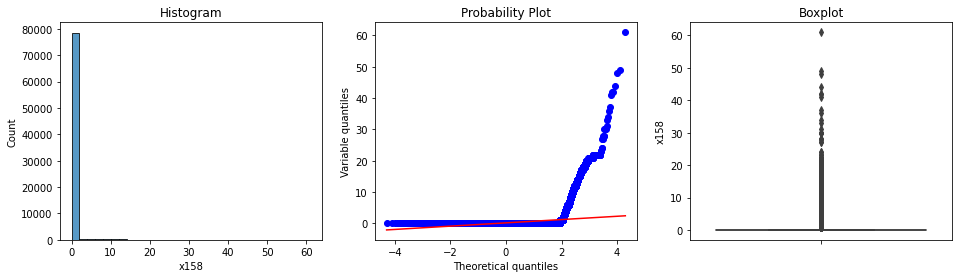

skewness of x158 is 11.22


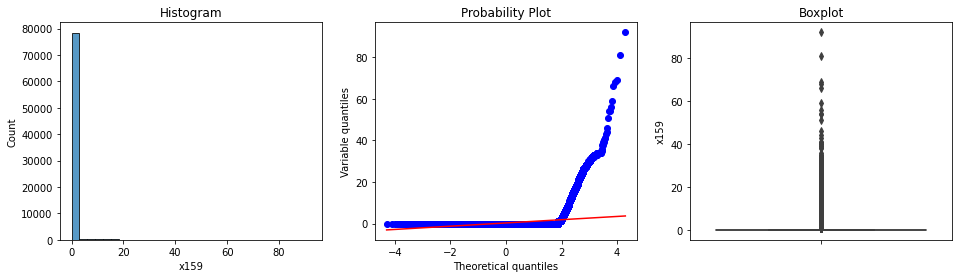

skewness of x159 is 11.37


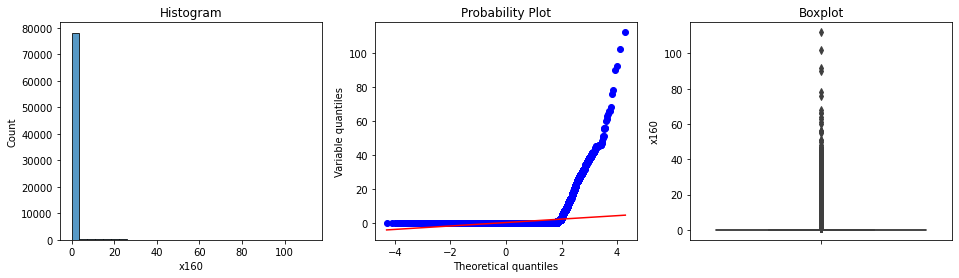

skewness of x160 is 11.39


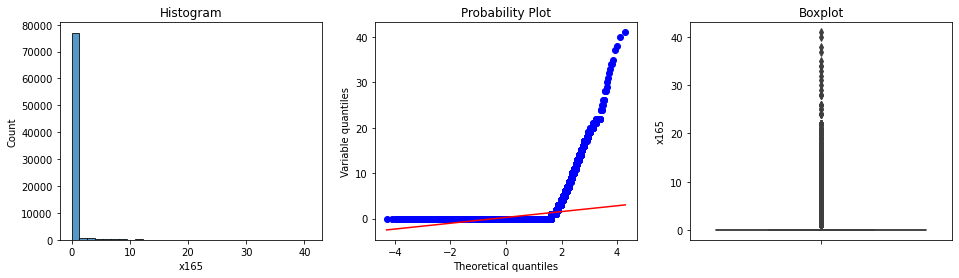

skewness of x165 is 9.04


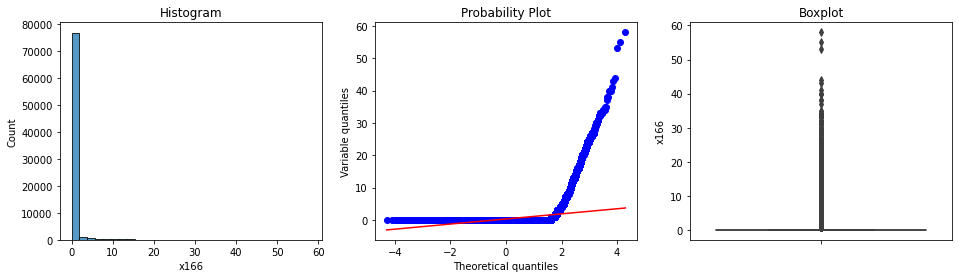

skewness of x166 is 9.70


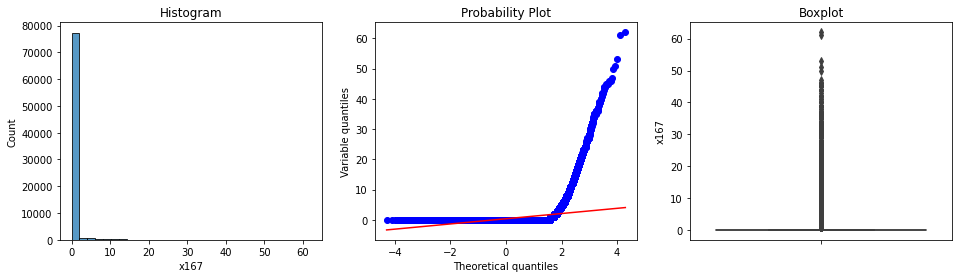

skewness of x167 is 10.37


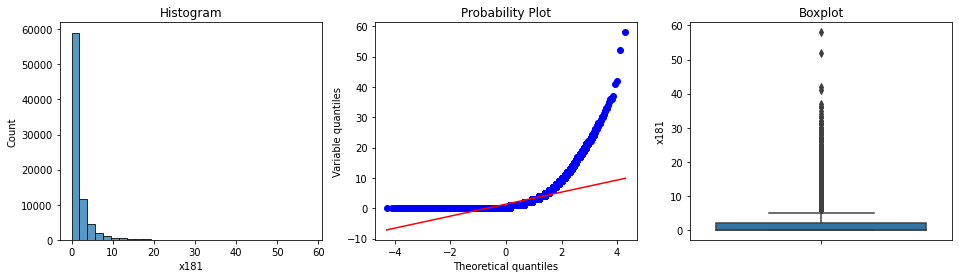

skewness of x181 is 4.08


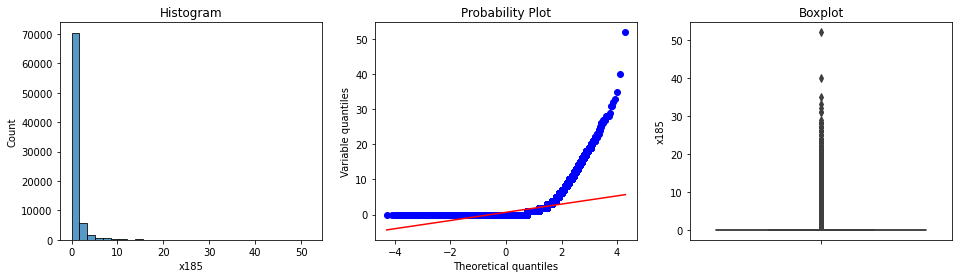

skewness of x185 is 5.99


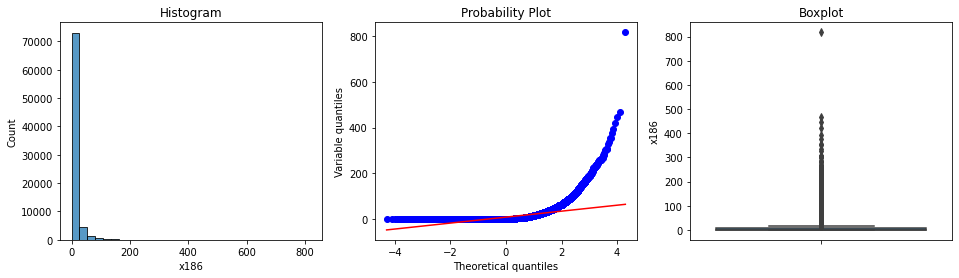

skewness of x186 is 6.32


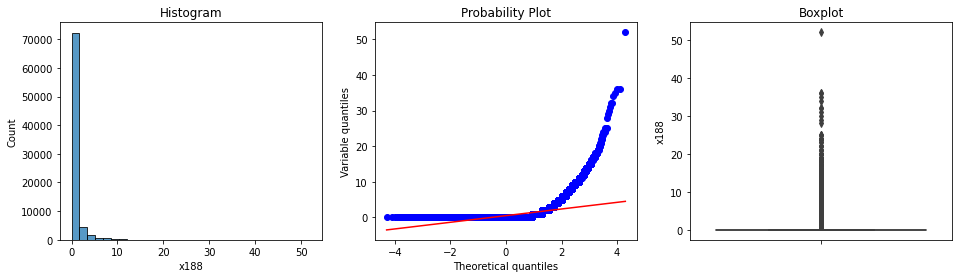

skewness of x188 is 6.31


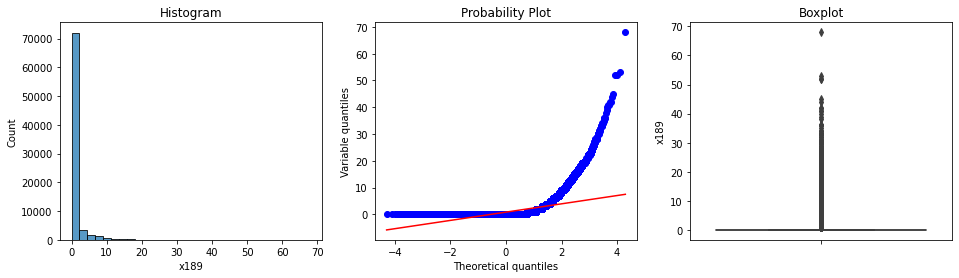

skewness of x189 is 5.65


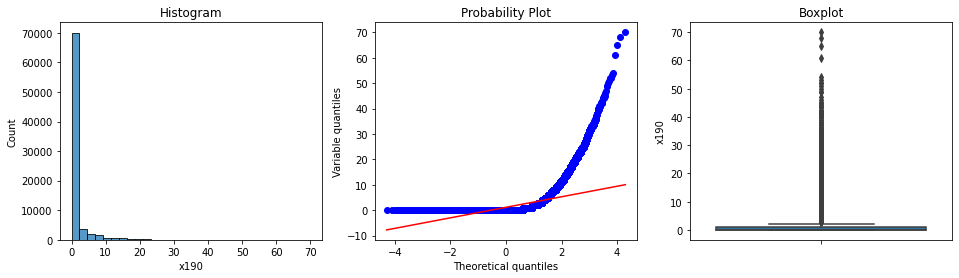

skewness of x190 is 5.43


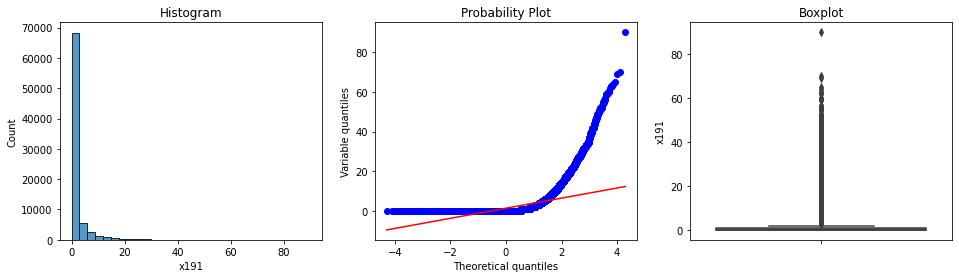

skewness of x191 is 5.40


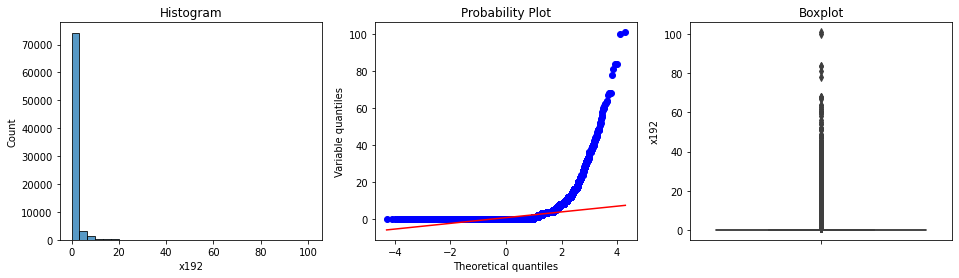

skewness of x192 is 9.69


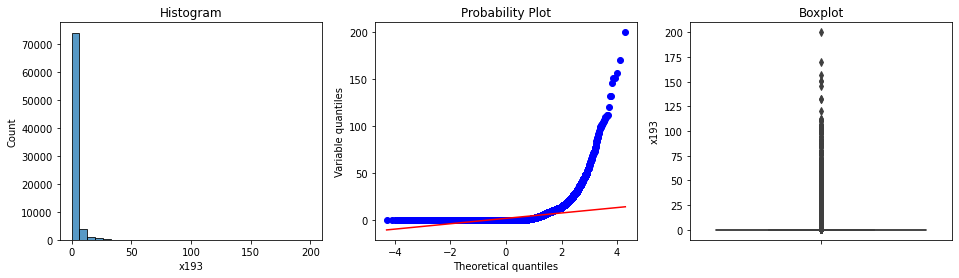

skewness of x193 is 9.74


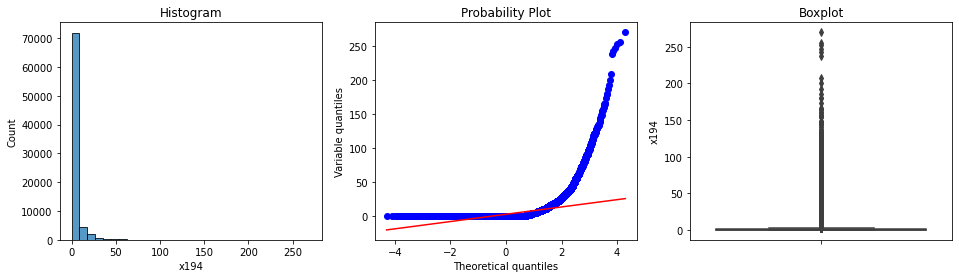

skewness of x194 is 7.97


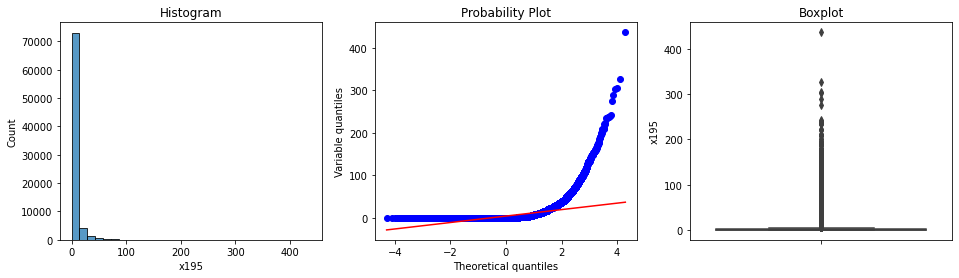

skewness of x195 is 7.39


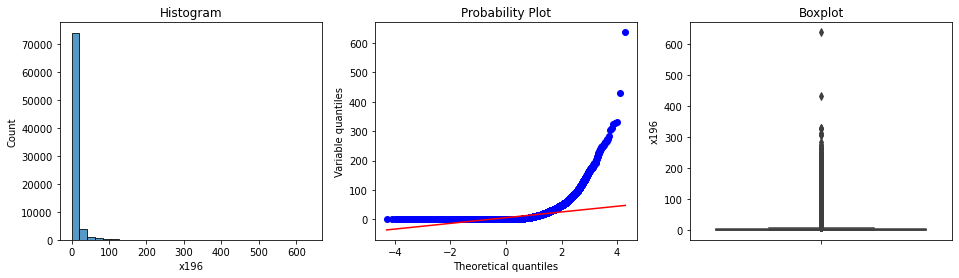

skewness of x196 is 7.22


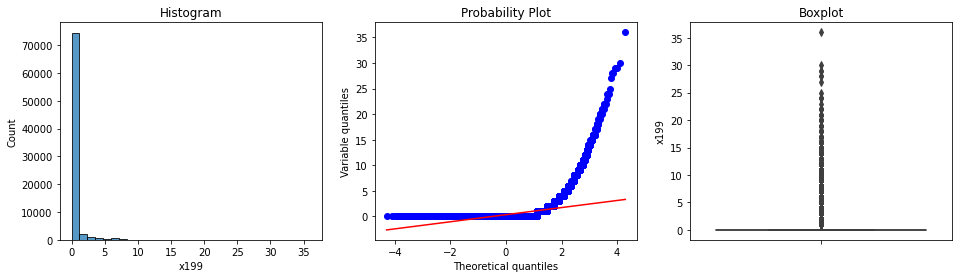

skewness of x199 is 7.39


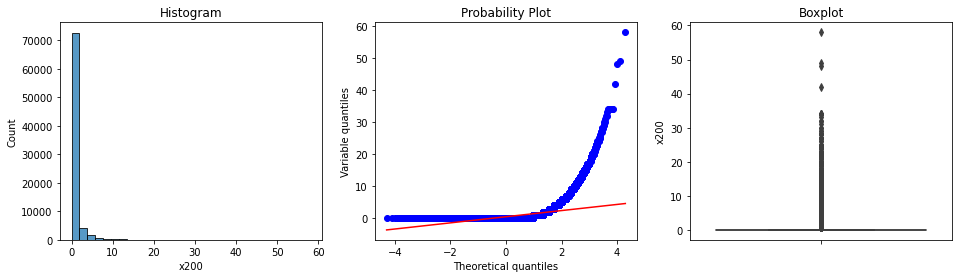

skewness of x200 is 7.56


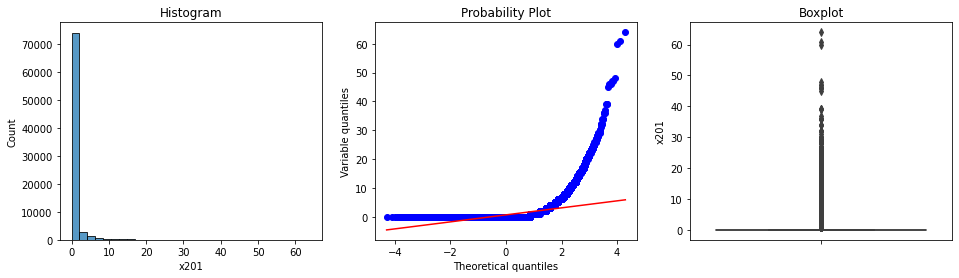

skewness of x201 is 7.36


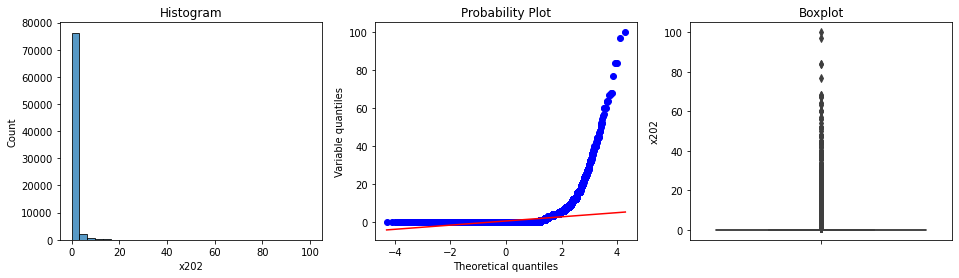

skewness of x202 is 12.73


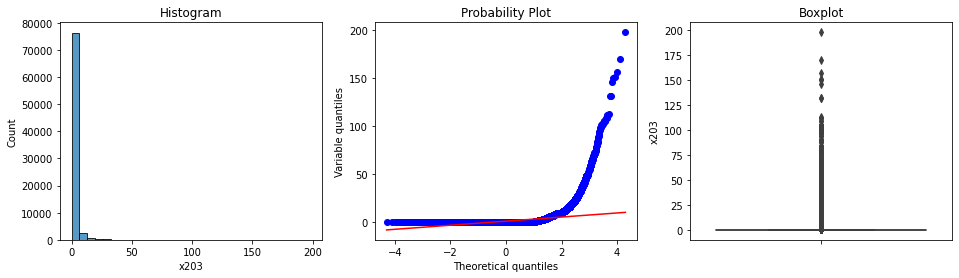

skewness of x203 is 12.70


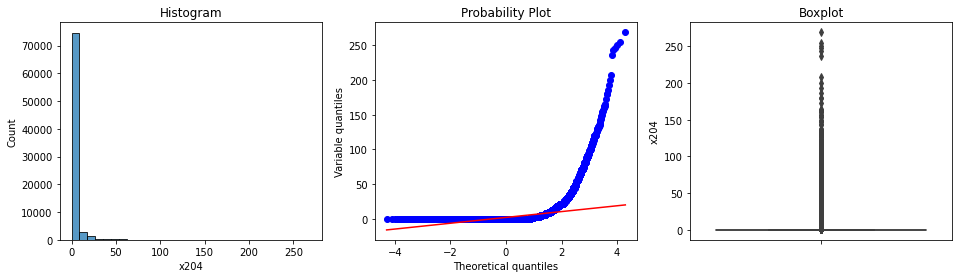

skewness of x204 is 9.85


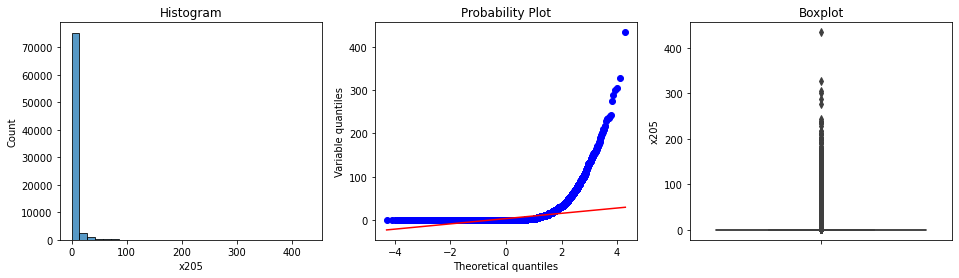

skewness of x205 is 8.93


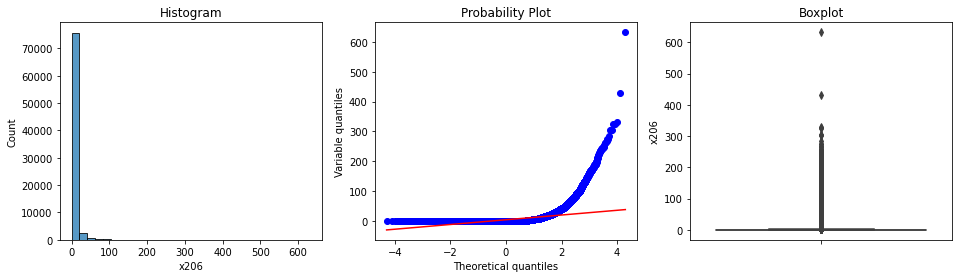

skewness of x206 is 8.65


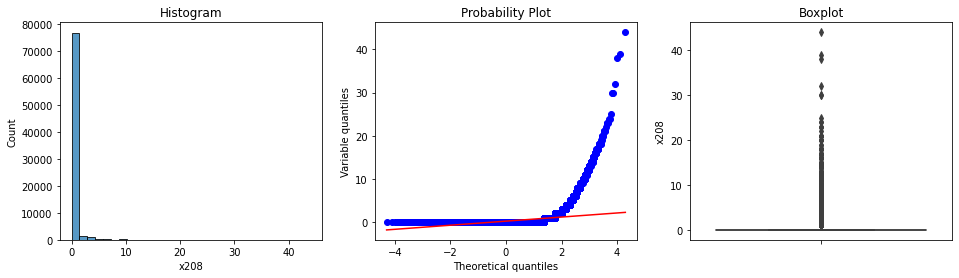

skewness of x208 is 10.95


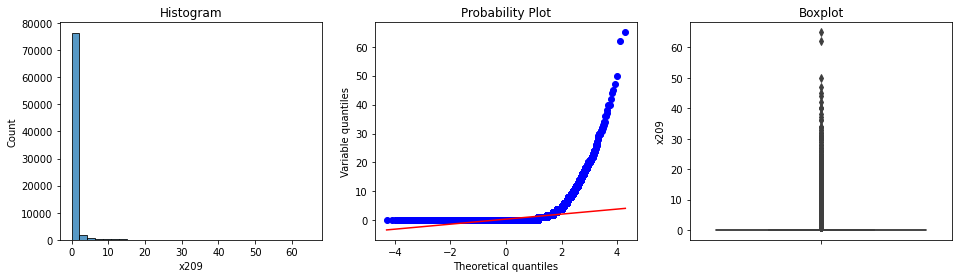

skewness of x209 is 9.66


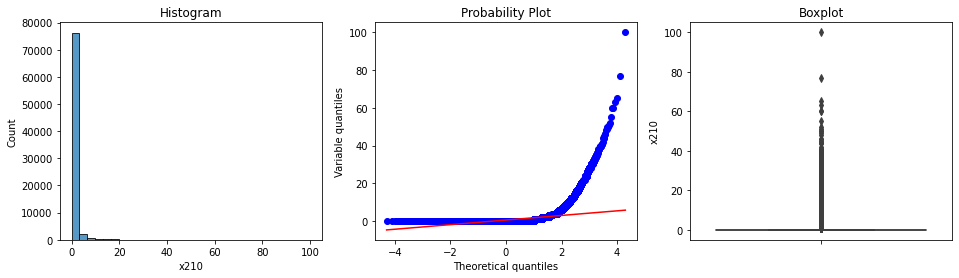

skewness of x210 is 9.51


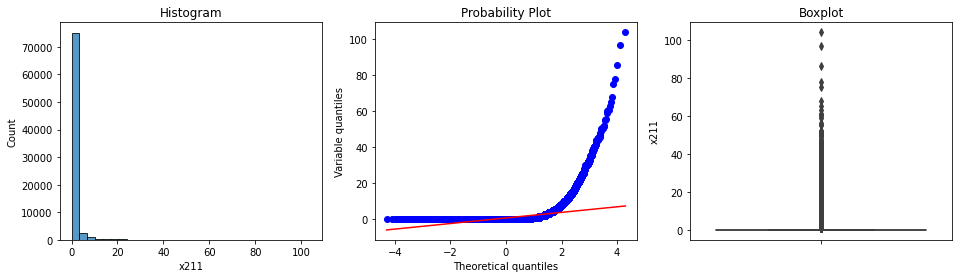

skewness of x211 is 9.01


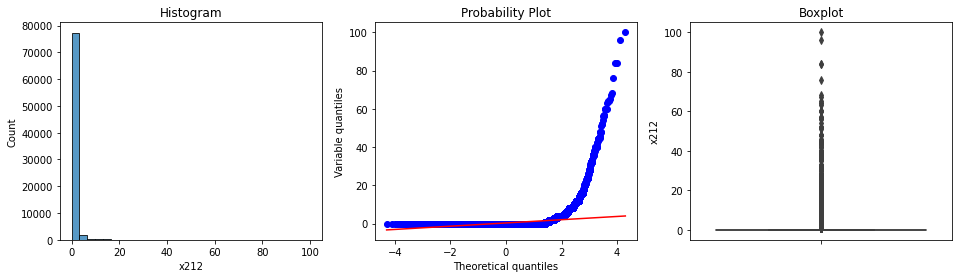

skewness of x212 is 15.72


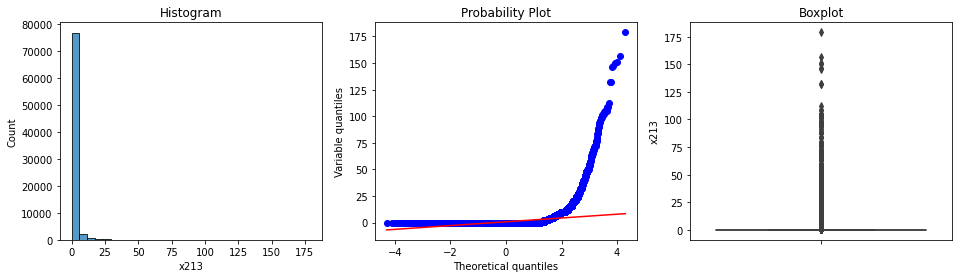

skewness of x213 is 14.05


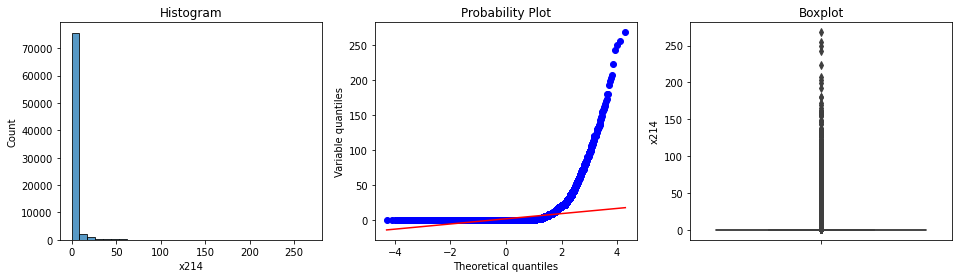

skewness of x214 is 10.57


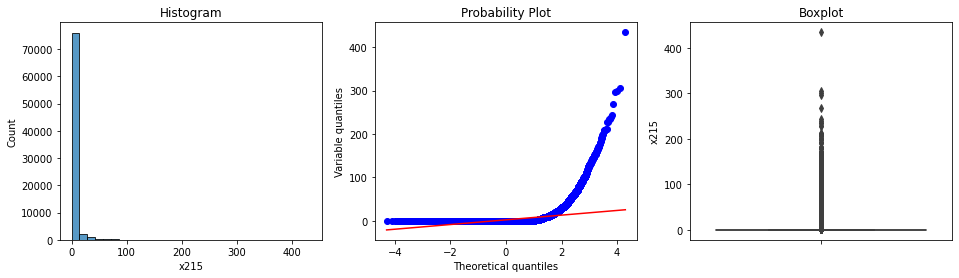

skewness of x215 is 9.46


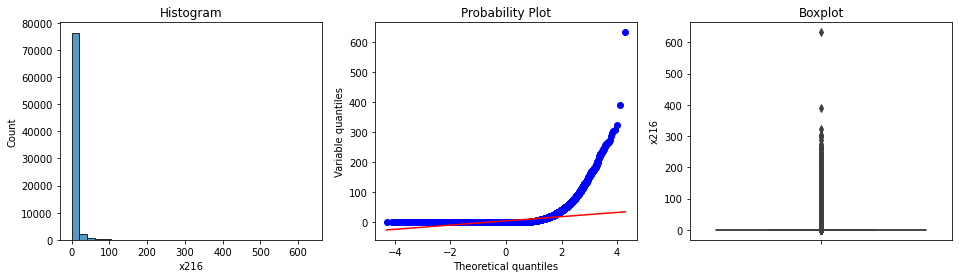

skewness of x216 is 9.17


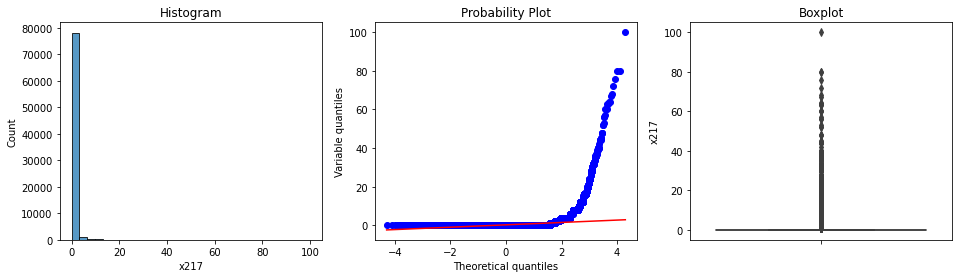

skewness of x217 is 19.57


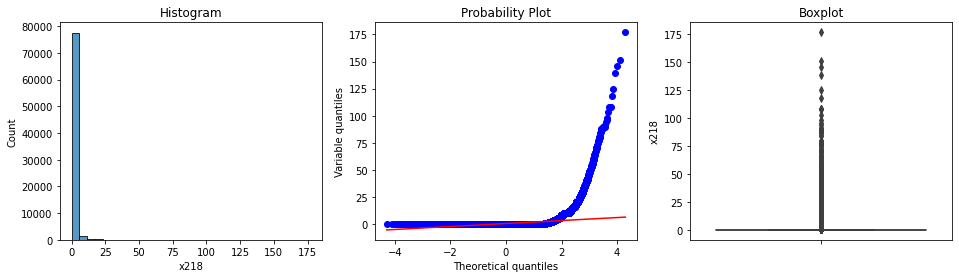

skewness of x218 is 15.64


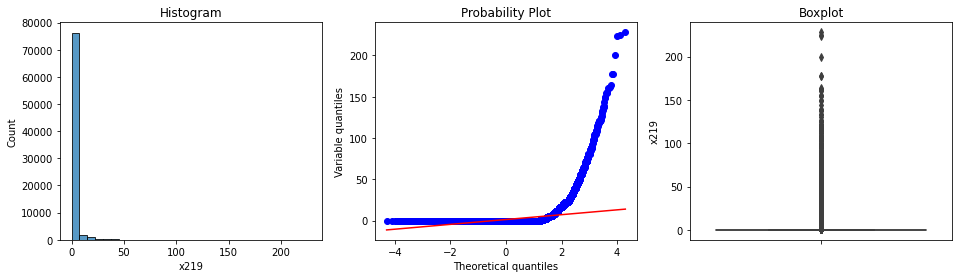

skewness of x219 is 11.06


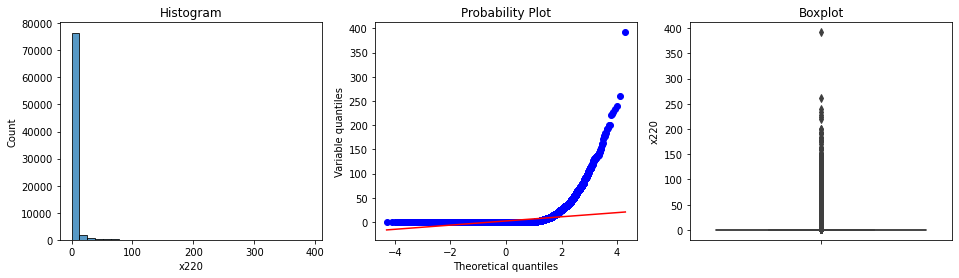

skewness of x220 is 9.81


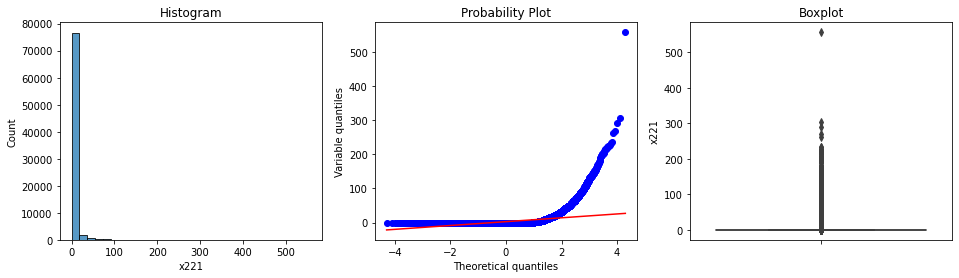

skewness of x221 is 9.48


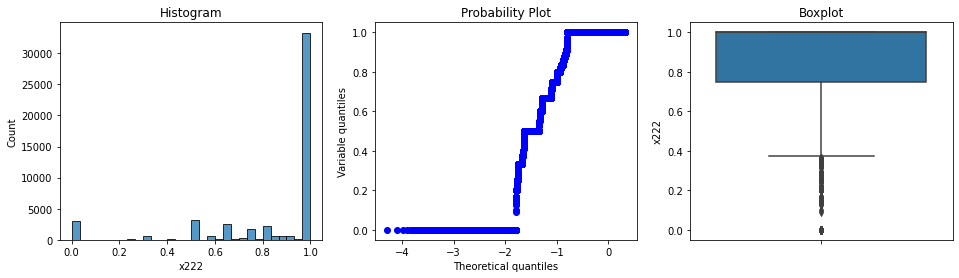

skewness of x222 is -1.96


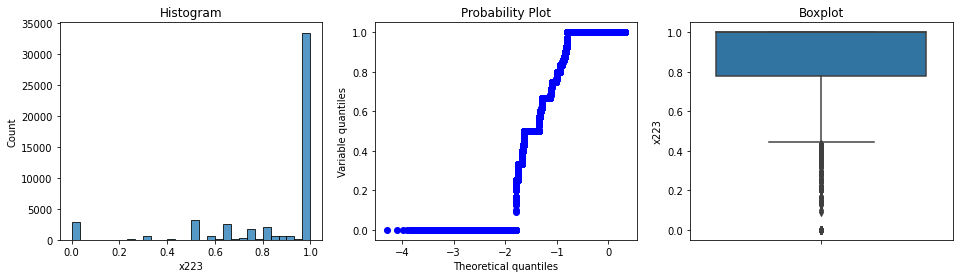

skewness of x223 is -1.98


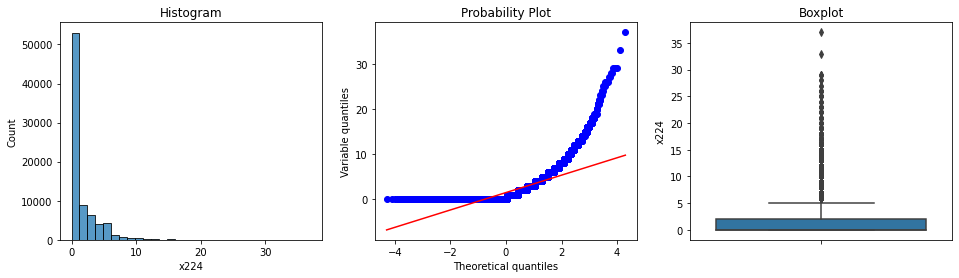

skewness of x224 is 2.68


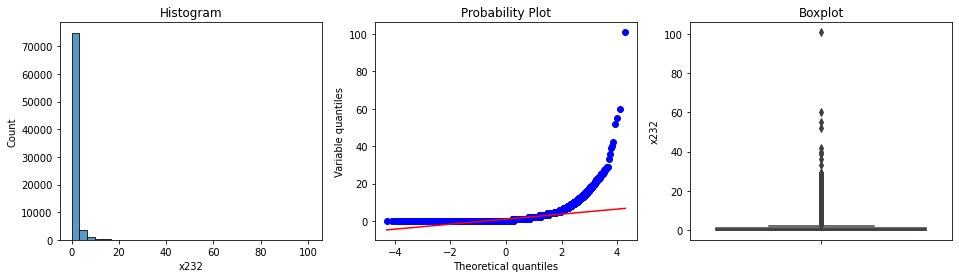

skewness of x232 is 7.12


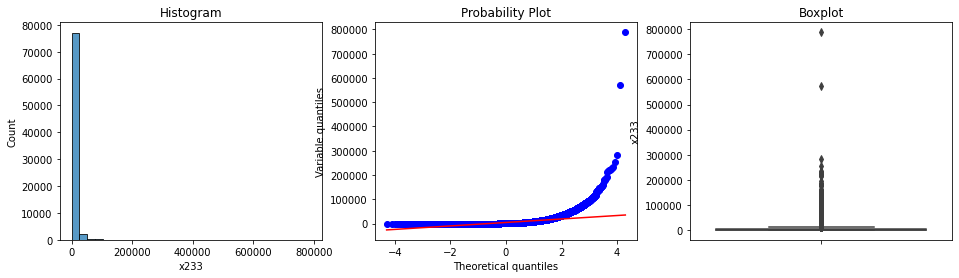

skewness of x233 is 11.69


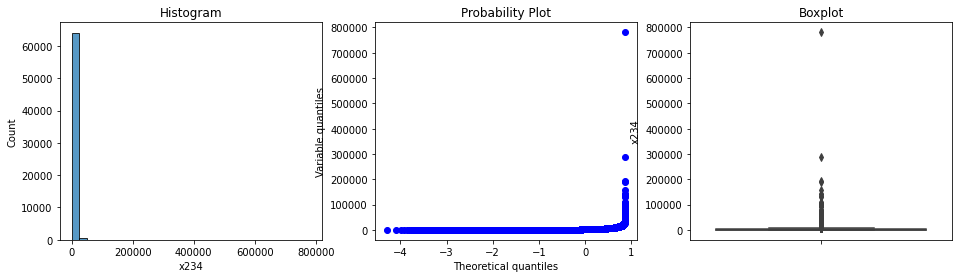

skewness of x234 is 32.63


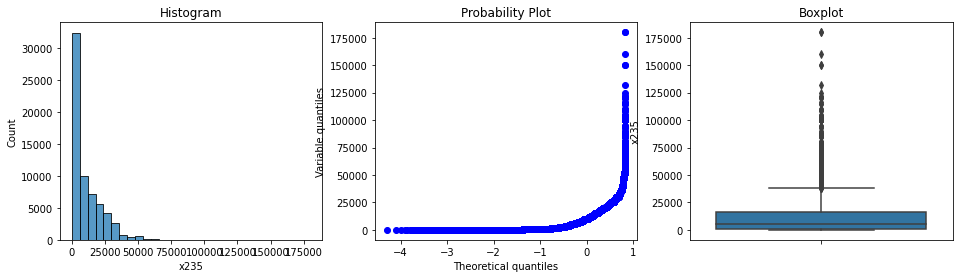

skewness of x235 is 2.03


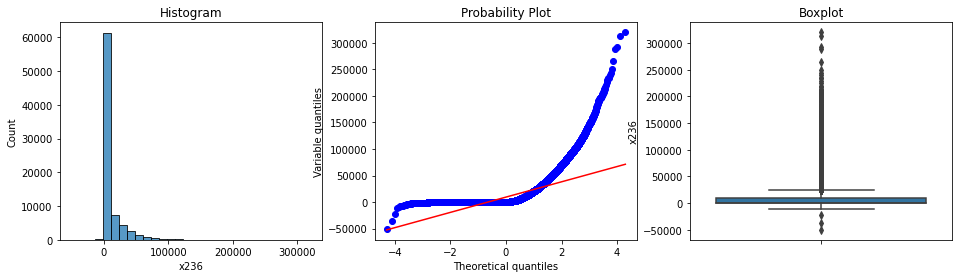

skewness of x236 is 3.51


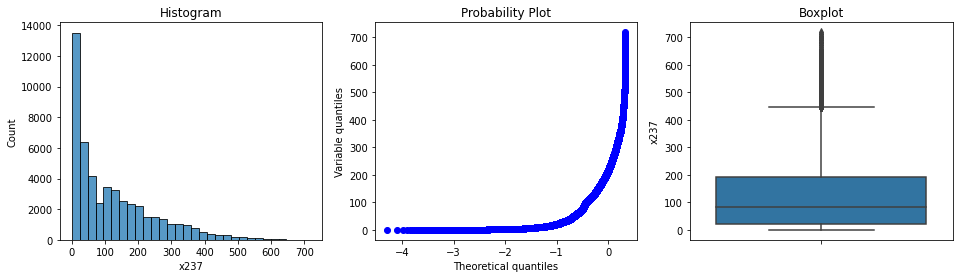

skewness of x237 is 1.25


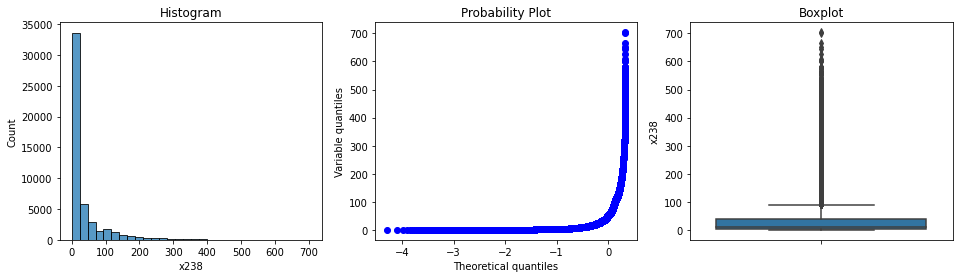

skewness of x238 is 3.11


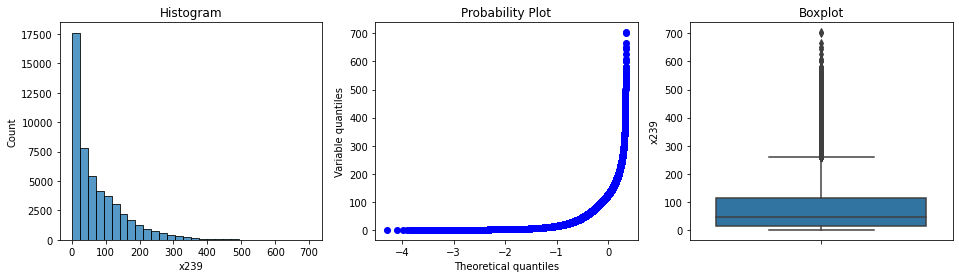

skewness of x239 is 1.74


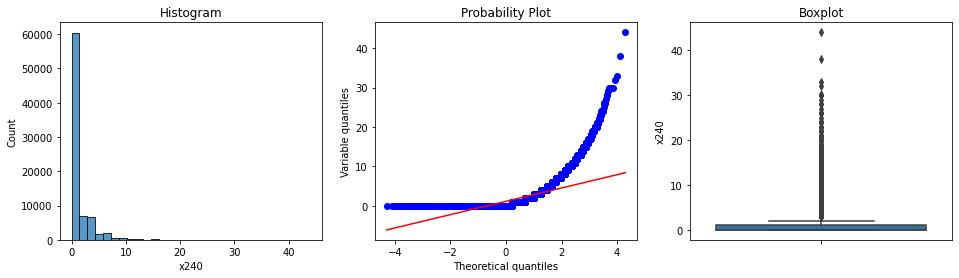

skewness of x240 is 3.53


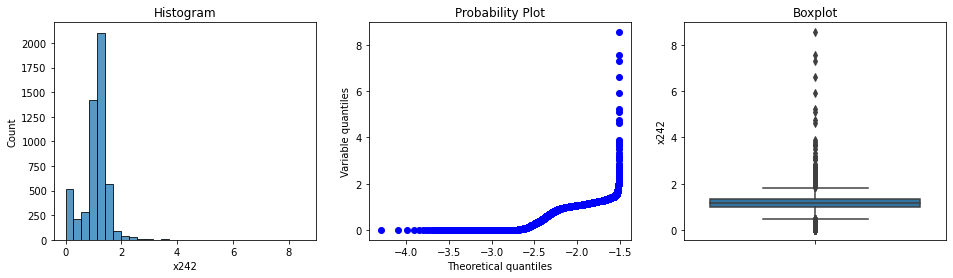

skewness of x242 is 1.72


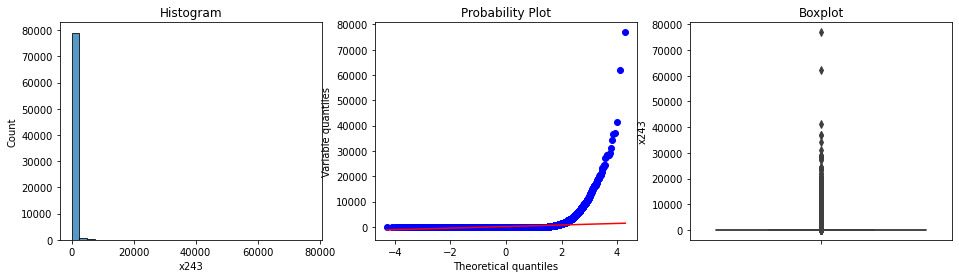

skewness of x243 is 22.55


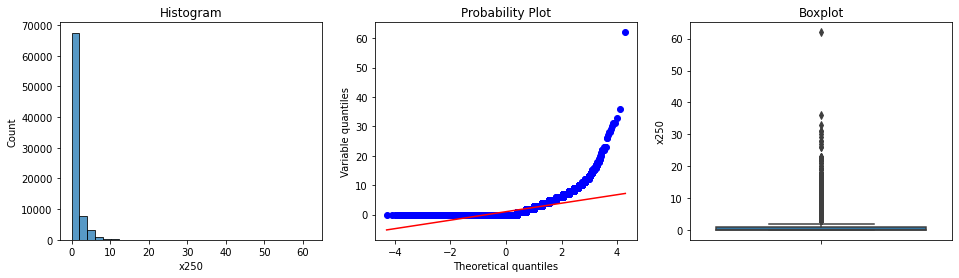

skewness of x250 is 3.50


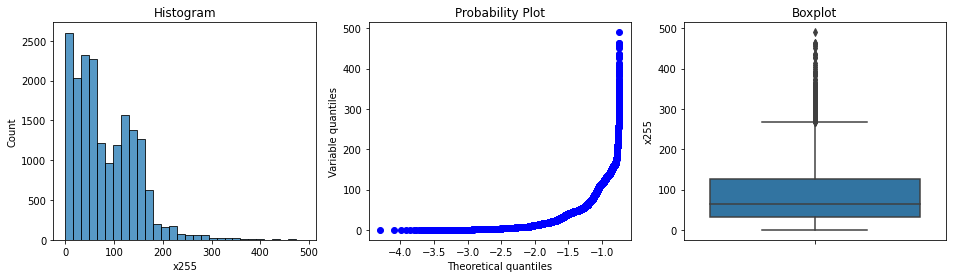

skewness of x255 is 1.04


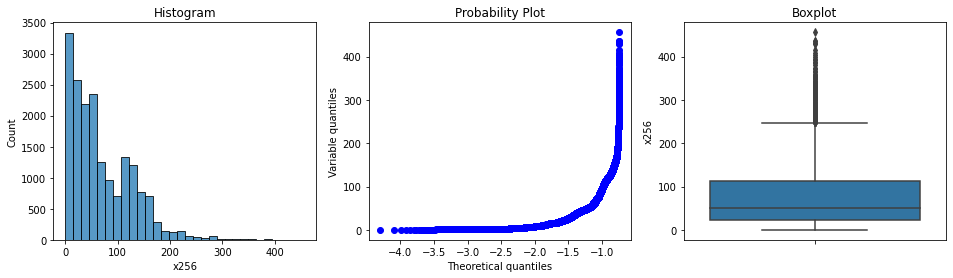

skewness of x256 is 1.24


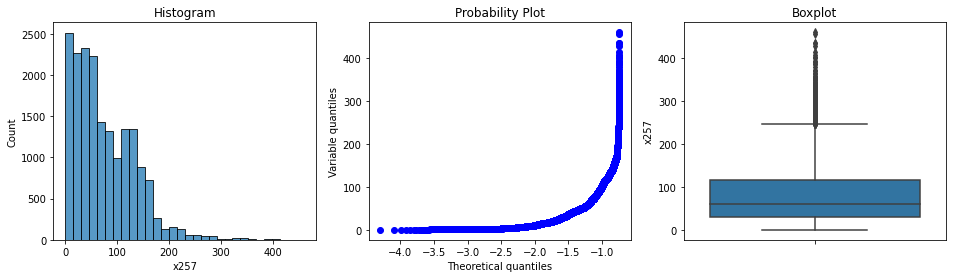

skewness of x257 is 1.13


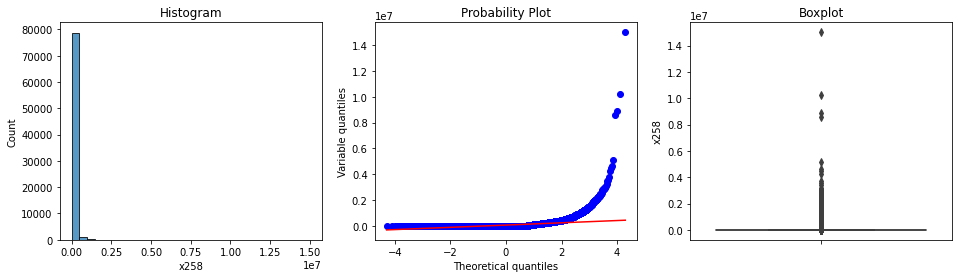

skewness of x258 is 21.54


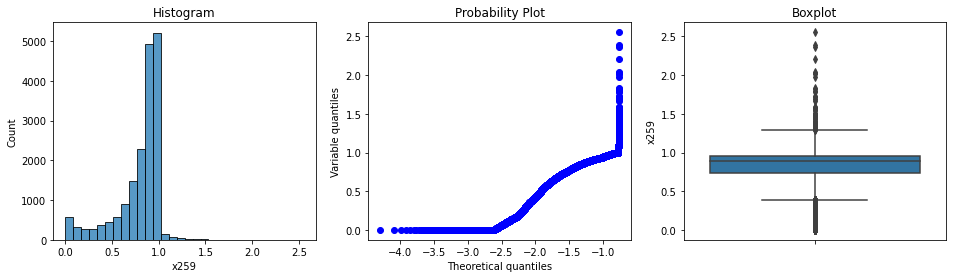

skewness of x259 is -1.48


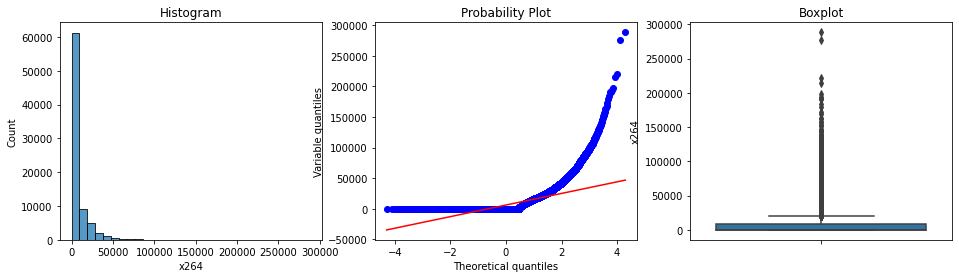

skewness of x264 is 3.71


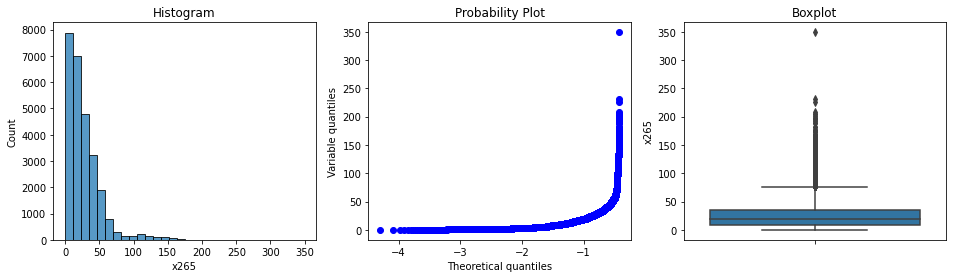

skewness of x265 is 2.38


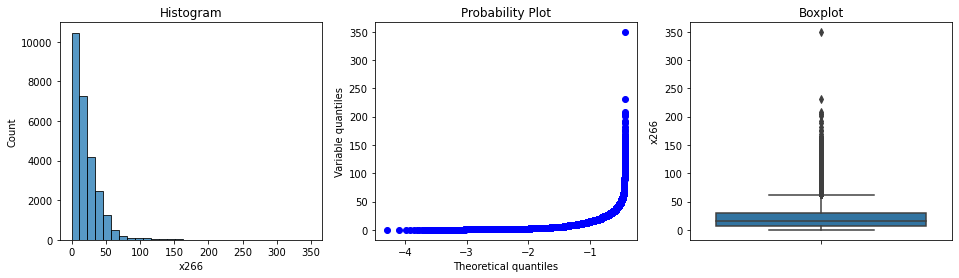

skewness of x266 is 2.67


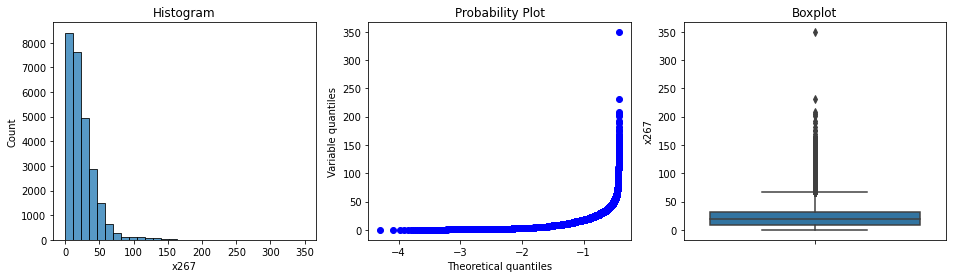

skewness of x267 is 2.42


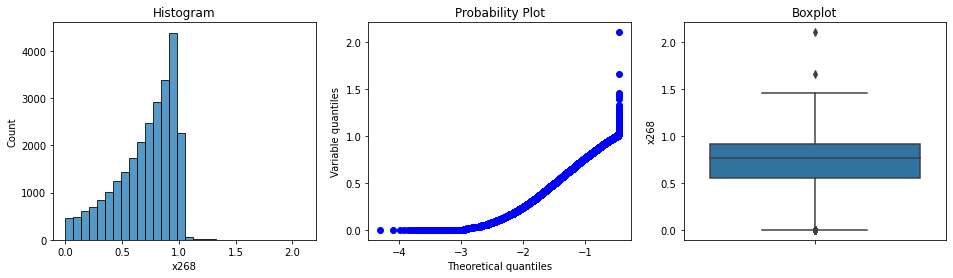

skewness of x268 is -0.84


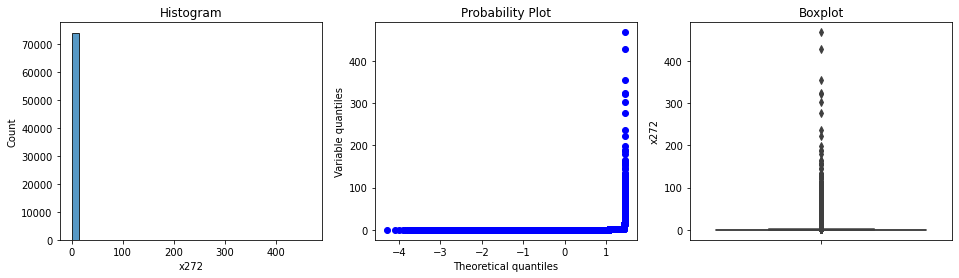

skewness of x272 is 45.18


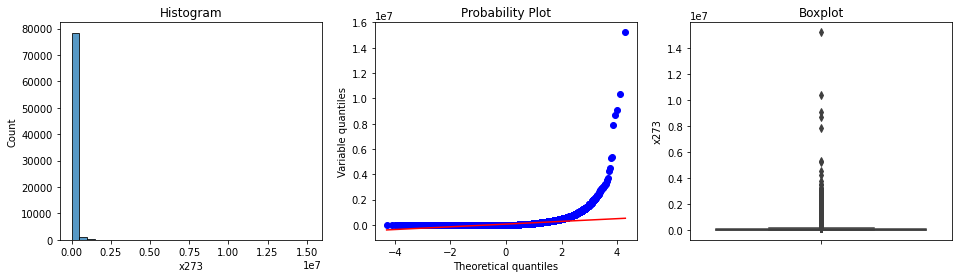

skewness of x273 is 19.11


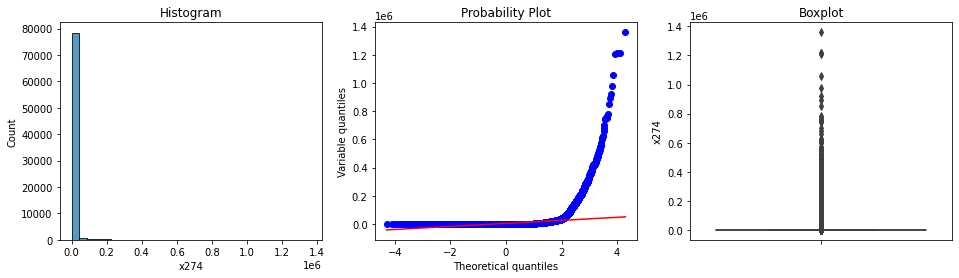

skewness of x274 is 16.73


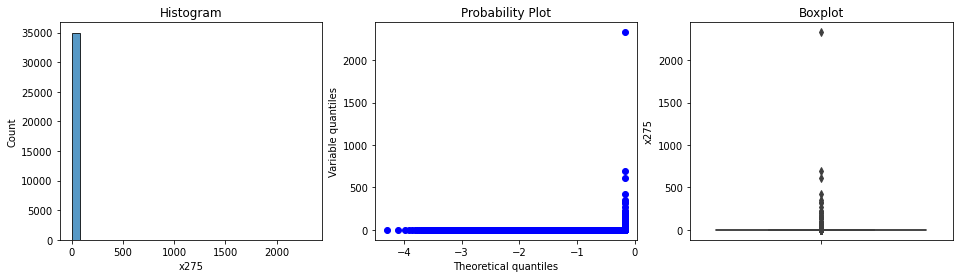

skewness of x275 is 125.87


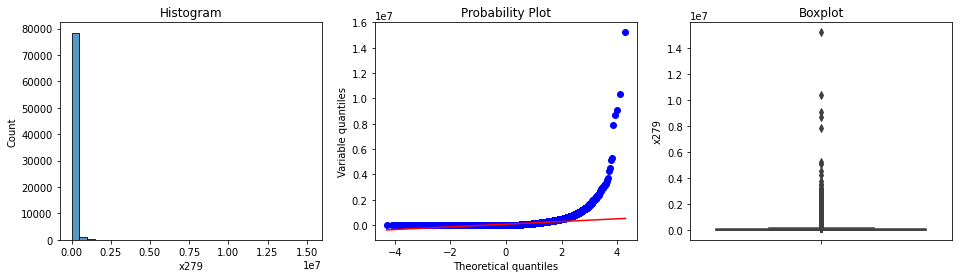

skewness of x279 is 19.29


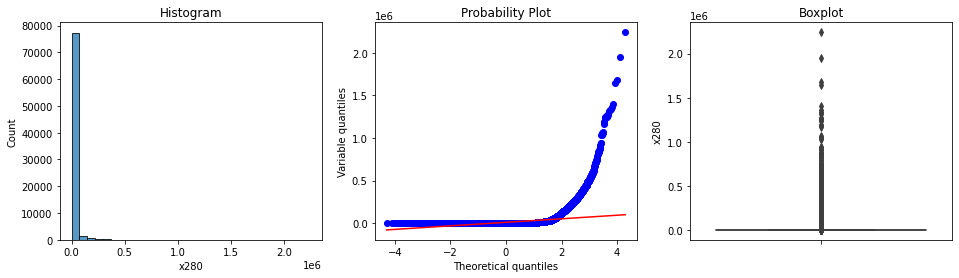

skewness of x280 is 12.99


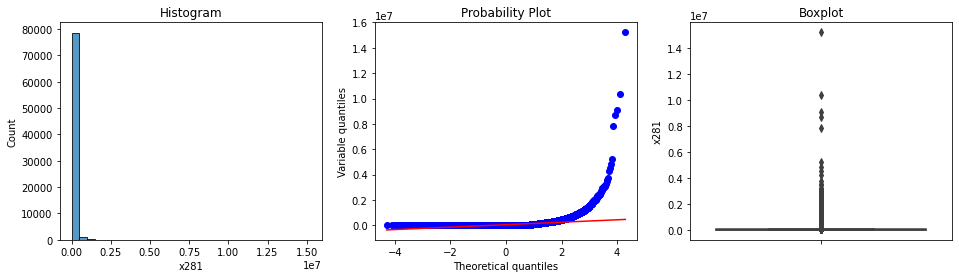

skewness of x281 is 21.19


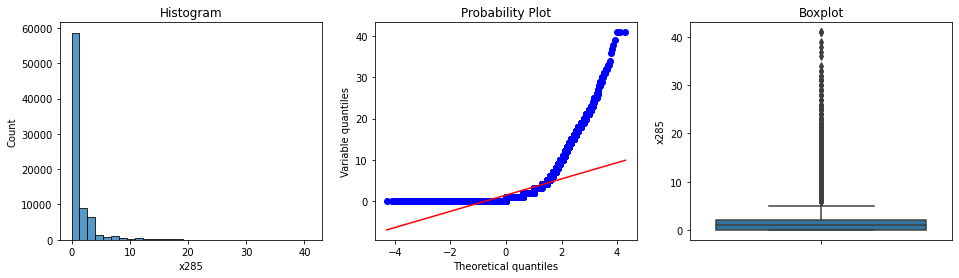

skewness of x285 is 4.17


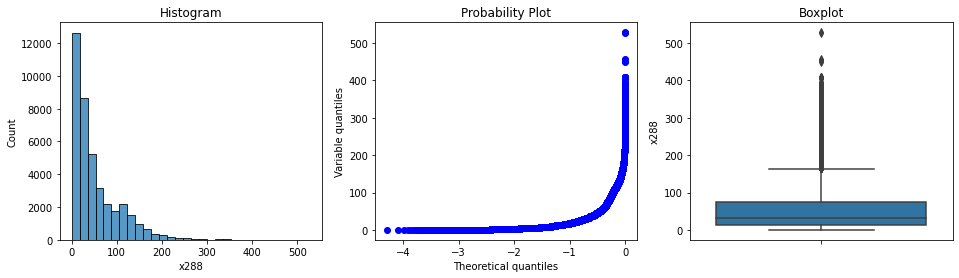

skewness of x288 is 1.76


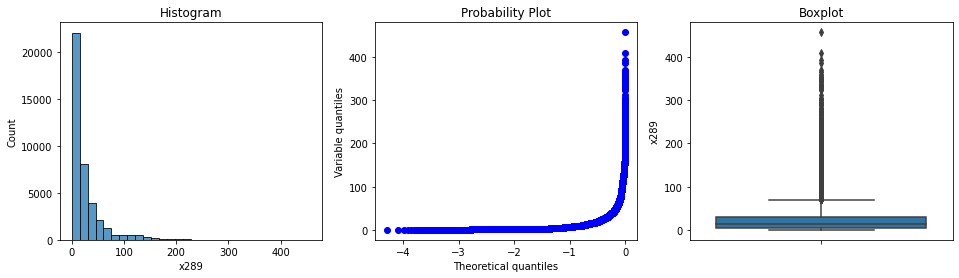

skewness of x289 is 3.16


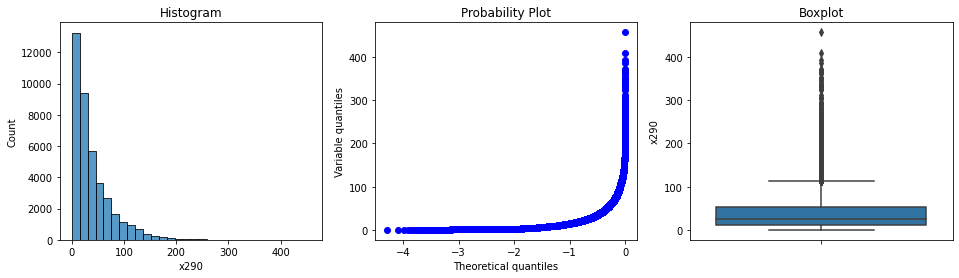

skewness of x290 is 2.18


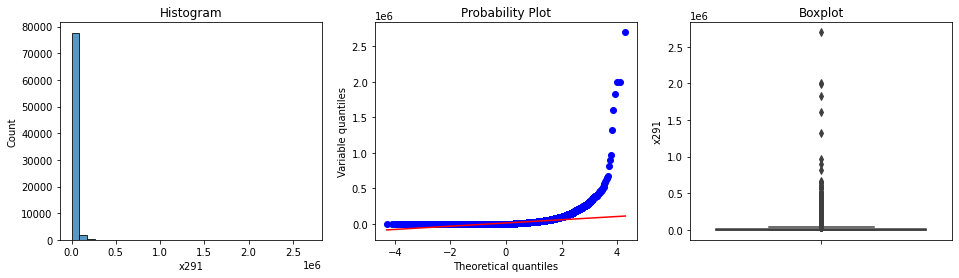

skewness of x291 is 16.71


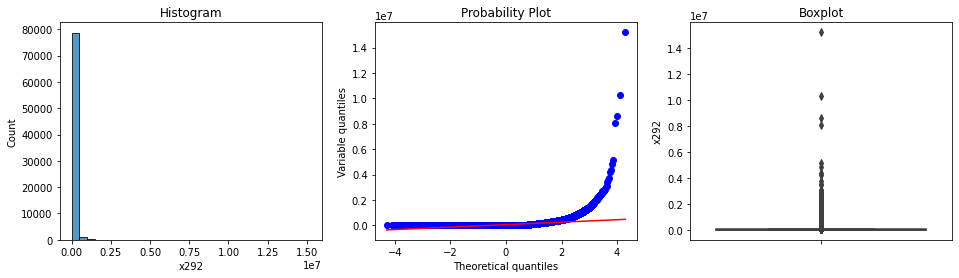

skewness of x292 is 20.89


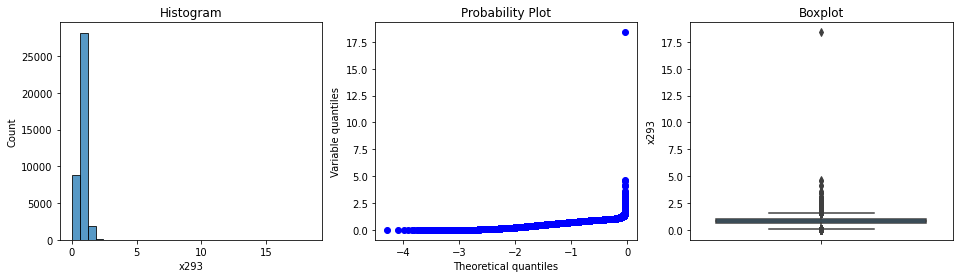

skewness of x293 is 4.56


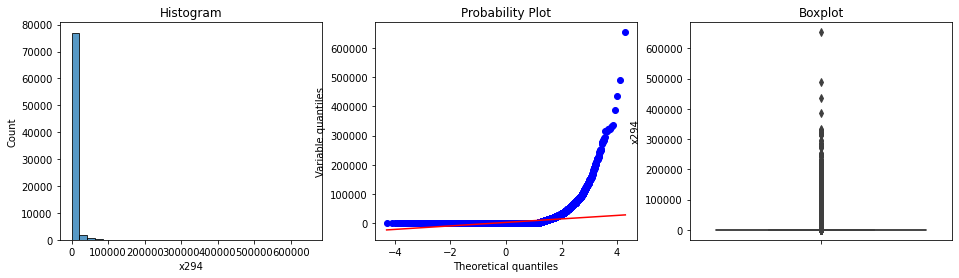

skewness of x294 is 12.08


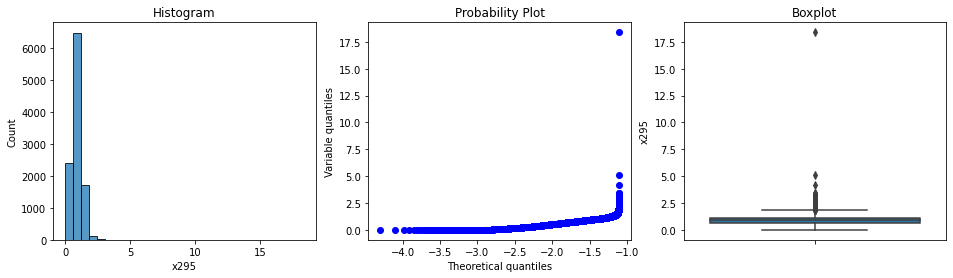

skewness of x295 is 6.49


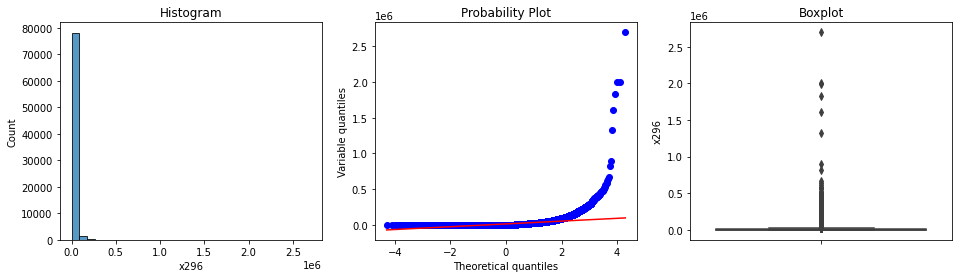

skewness of x296 is 20.28


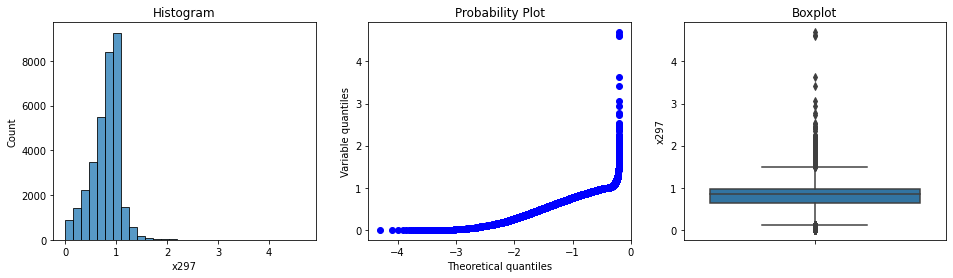

skewness of x297 is -0.05


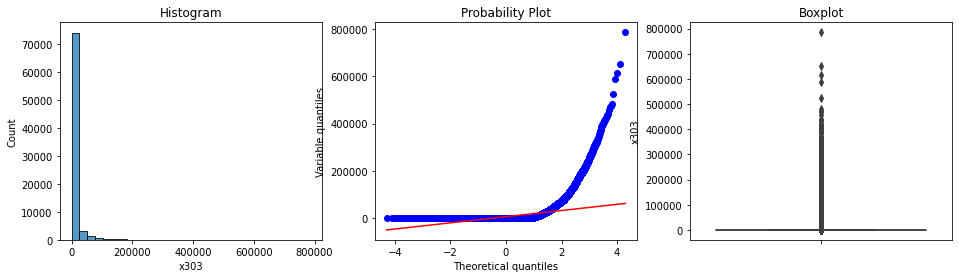

skewness of x303 is 7.68


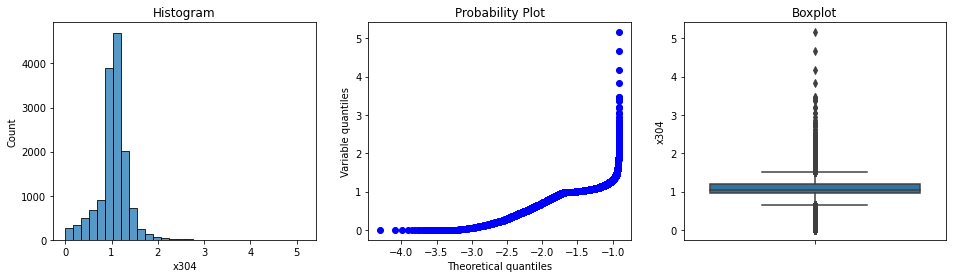

skewness of x304 is 0.27


In [17]:
# plotting the continuous variables
for variable in cont_vars:
    diagnostic_plots(df_train, variable)
    # printing skewness
    skewness = df_train[variable].skew()
    print(f"skewness of {variable} is {skewness:.2f}")

Discussion: Most variables are skewed or/and have high kurtosis. Some of them have outliers on one or both sides.<br>
Highly skewed variables: 'x044', 'x045', 'x234', 'x272', 'x275'

In [18]:
# making a list of skewed variables
skewed = ['x044', 'x045', 'x234', 'x272', 'x275']

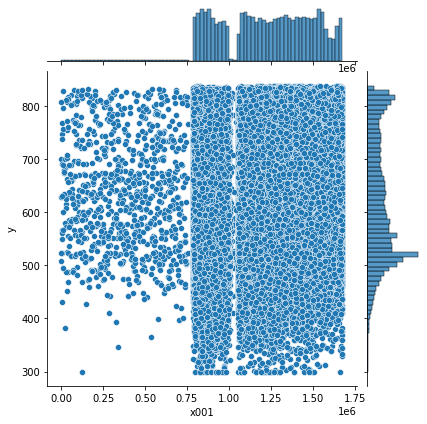

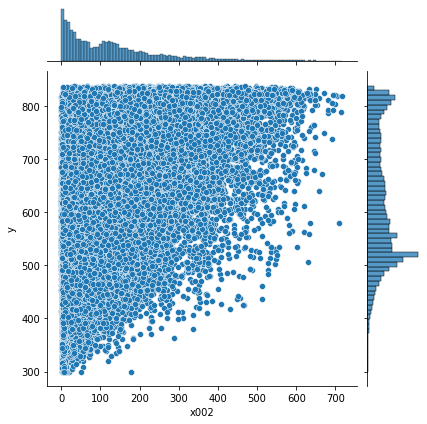

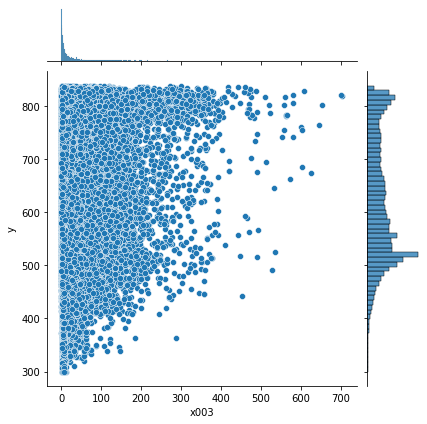

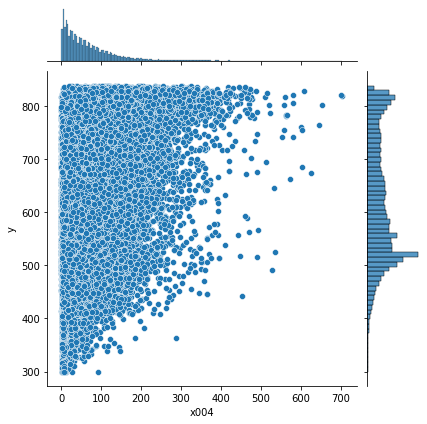

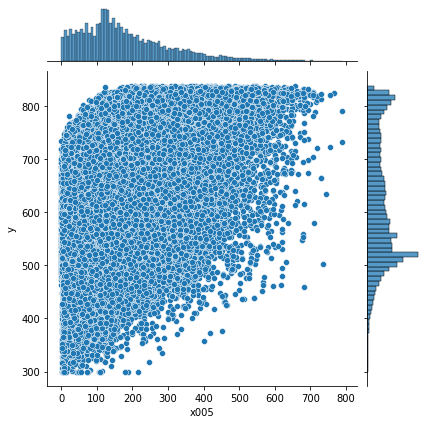

...

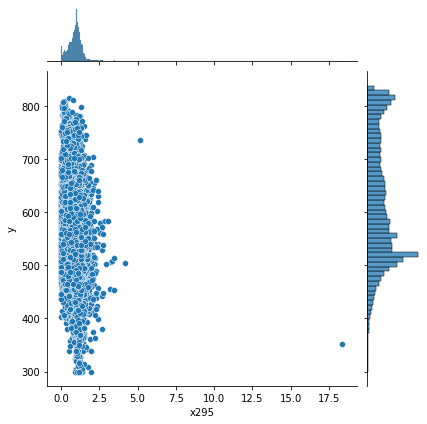

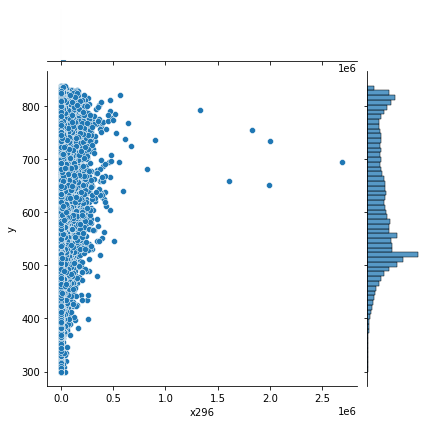

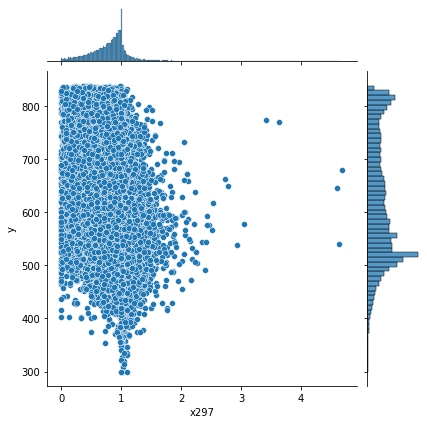

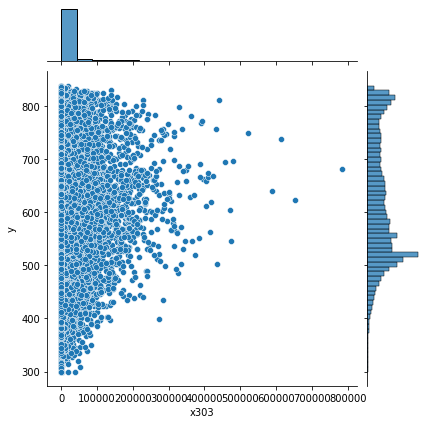

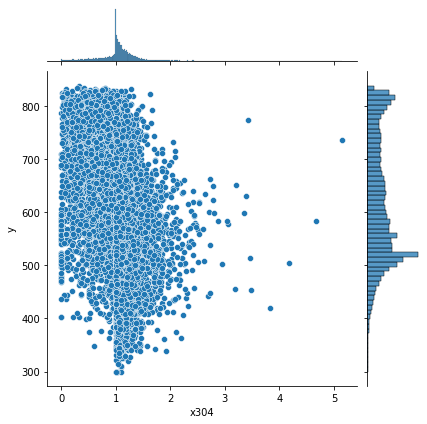

In [19]:
# influence of continuous variables on the targers
for var in cont_vars:
        sns.jointplot(data=df_train, x=var, y=target)

The continuous variables seem slightly to not correlated with the target.

<b>Skewed variables</b>

Transforming skewed variables into binary variables and seeing how predictive they are.

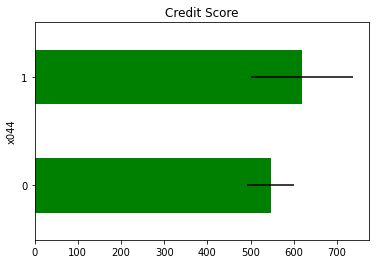

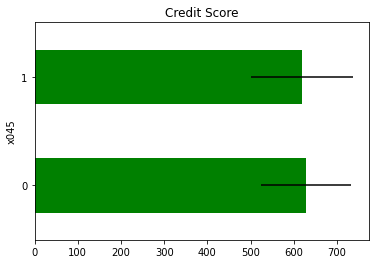

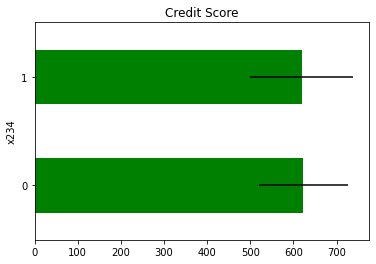

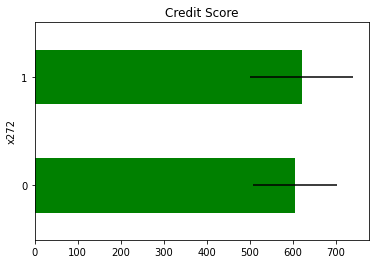

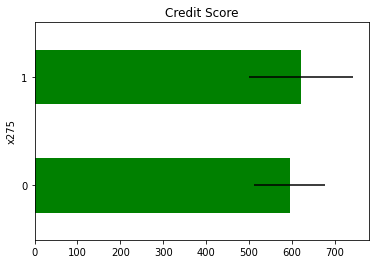

In [20]:
for var in skewed:
    tmp = df_train.copy()
    # maping the variable values into 0 and 1
    tmp[var] = np.where(df_train[var] == 0, 0, 1)
    # determining mean sale price in the mapped values
    tmp = tmp.groupby(var)['y'].agg(['mean', 'std'])
    # plotting into a bar graph
    tmp.plot(kind="barh", y="mean", legend=False,
             xerr="std", title="Credit Score", color='green')
    plt.show()

Discussion: 'x044' seems to be predictive.